In [1]:
!pip install Twython
import pandas as pd
import numpy as np 
from twython import Twython
import requests
from bs4 import BeautifulSoup
from datetime import datetime
import ast
import time
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from collections import Counter
from nltk.corpus import stopwords
from nltk.util import ngrams
from sklearn.feature_extraction.text import CountVectorizer
plt.style.use('ggplot')

CONSUMER_KEY = "DyoTjohC4arsxLFBjmh71l5Fi"
CONSUMER_SECRET = "sWE3WV27dOOsZnRpSo19bZCojZykVqftYh1uAQvCwqviro4jT1"
OAUTH_TOKEN = "1133494860554604545-aQrvZDpNyxgi6MwQbHegX8Bkx6CUfI"
OAUTH_TOKEN_SECRET = "inqueIKTVIqqKGXKiHS7dOwNvSmCQdWgYN83ih1kQkNkS"
twitter = Twython(
    CONSUMER_KEY, CONSUMER_SECRET,
    OAUTH_TOKEN, OAUTH_TOKEN_SECRET)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Aris Portosalte

In [2]:
Aris = []
try:
    user_timeline = twitter.get_user_timeline(screen_name='ArisPortosalte',count=300, tweet_mode = 'extended'  )
except TwythonError as e:
    print("Error getting tweets:", e)
print("I Got:", len(user_timeline), " tweets")
for tweet in user_timeline:
    # Add whatever you want from the tweet, here we just add the text
    Aris.append(tweet)

I Got: 200  tweets


In [3]:
pd.DataFrame(Aris)

,created_at,id,id_str,full_text,truncated,display_text_range,entities,source,in_reply_to_status_id,in_reply_to_status_id_str,...,favorite_count,favorited,retweeted,lang,extended_entities,possibly_sensitive,retweeted_status,quoted_status_id,quoted_status_id_str,quoted_status_permalink
0,Wed Jul 06 18:39:38 +0000 2022,1544752953038442497,1544752953038442497,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,False,"[0, 160]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,770,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
1,Tue Jul 05 09:14:43 +0000 2022,1544248396378263553,1544248396378263553,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,False,"[0, 237]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,322,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
2,Sun Jul 03 20:27:17 +0000 2022,1543692879406694402,1543692879406694402,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",False,"[0, 110]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,454,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
3,Fri Jul 01 04:19:02 +0000 2022,1542724436368965633,1542724436368965633,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,False,"[0, 268]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,456,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
4,Fri Jul 01 03:56:35 +0000 2022,1542718786696089602,1542718786696089602,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,False,"[245, 460]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",1.542689e+18,1542689218723545089,...,8,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,Mon Jan 24 08:22:42 +0000 2022,1485528473452134400,1485528473452134400,@TasosMalamas @myrtozax @Athanasiosfara1 @Aris...,False,"[232, 483]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",1.485462e+18,1485462364937850882,...,15,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
196,Fri Jan 21 19:24:16 +0000 2022,1484607797027385348,1484607797027385348,Ενόχλησε την αισθητική του Α.Τσίπρα η παρουσία...,False,"[0, 279]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,787,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN
197,Fri Jan 21 14:04:45 +0000 2022,1484527389182992388,1484527389182992388,RT @ellada24: Βόμβα Ζωής Κωνσταντοπούλου: Εντε...,False,"[0, 140]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,0,False,False,el,NaN,False,{'created_at': 'Thu Jan 20 09:03:54 +0000 2022...,NaN,NaN,NaN
198,Fri Jan 21 08:58:48 +0000 2022,1484450395204300802,1484450395204300802,Δημοσιεύτηκαν στις 3/2/2018 στο Ντοκουμέντο-Βα...,False,"[0, 277]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,771,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
# Count could be less than 200, see:
# https://dev.twitter.com/discussions/7513
while len(user_timeline) != 0: 
    try:
        user_timeline = twitter.get_user_timeline(screen_name='ArisPortosalte',count=100,
                                                  tweet_mode = 'extended', max_id=user_timeline[len(user_timeline)-1]['id']-1)
    except TwythonError as e:
        print("Error getting tweets:", e)
    if len(user_timeline) > 0:
        print("I Got:", len(user_timeline), " tweets more... Last ID:", user_timeline[len(user_timeline)-1]['id']-1)
    for tweet in user_timeline:
        # Add whatever you want from the tweet, here we just add the text
        Aris.append(tweet)
# Number of tweets the user has made
print("I got :", len(Aris), " in total!!!")

I Got: 100  tweets more... Last ID: 1456385854163783684
I Got: 100  tweets more... Last ID: 1430219778975846402
I Got: 100  tweets more... Last ID: 1407924179186356223
I Got: 100  tweets more... Last ID: 1385091210998652927
I Got: 100  tweets more... Last ID: 1362677570219757568
I Got: 100  tweets more... Last ID: 1344162514121187327
I Got: 100  tweets more... Last ID: 1327313380672221184
I Got: 100  tweets more... Last ID: 1311893357946376192
I Got: 100  tweets more... Last ID: 1295698768684294150
I Got: 100  tweets more... Last ID: 1274400142821675009
I Got: 100  tweets more... Last ID: 1258349440521437185
I Got: 100  tweets more... Last ID: 1246914836015046656
I Got: 100  tweets more... Last ID: 1233870989236359169
I Got: 100  tweets more... Last ID: 1218775710464204805
I Got: 100  tweets more... Last ID: 1201376031829045247
I Got: 100  tweets more... Last ID: 1187582333362286591
I Got: 100  tweets more... Last ID: 1169473808866172929
I Got: 100  tweets more... Last ID: 115506321912

In [5]:
# Number of tweets the user has made
print("I got :", len(Aris), " in total!!!")

I got : 3250  in total!!!


In [6]:
for tweet in Aris:
    print(tweet['created_at'],tweet['full_text'])

Streaming output truncated to the last 5000 lines.
Η ανεκτικότητα του Κράτους εξαντλείται μόνο στους ρομά;
Μόνο το σοβαρό Κράτος μπορεί να απαιτεί σοβαρότητα.
Ξέρουμε όλοι, ότι τους θέλουν μόνο για τις ψήφους..
Sat Apr 11 06:08:13 +0000 2020 @CMouroutis @TasosMalamas @gpapageorgiadis @liberalgreek @ArisZachos @Athanasiosfara1 @NikoSpagopoulos @johnkanellopo @AkiPapazoglou @peristeraRa @myrtozax @s_ntornta @fontasts @AdonisGeorgiadi @ManolidouE @LKousoulis Ευχαριστώ πολύ αγαπητέ φίλε @CMouroutis. Καλημέρα στη Σόφια. Υπάρχουν αρκετές, ενδιαφέρουσες επιλογές στα https://t.co/eHOTHfLCPx Μόλις επανέλθουμε στην κανονικότητα θα προστεθούν κι άλλες Ιστορικές σειρές. Κυρίως η Νεότερη Πολιτική Ιστορία της Ελλάδας. Έως τότε:
Καλή ακρόαση..
Sat Apr 11 05:47:45 +0000 2020 @SNikoloudakis Δεν θα διαφωνήσω, αλλά δεν επιτρέπεται σε μια.. πολιτισμένη πολιτεία να ζουν ανθρωποι μέσα στα σκουπιδια. Προφανώς σεβασμός αλλά κ ταυτοχρόνως εφαρμογή των Νόμων..
Sat Apr 11 05:04:31 +0000 2020 @panven123 Γιατί, εμ

In [7]:
#Aris[0]

In [8]:
Aris_df = pd.DataFrame(Aris)
Aris_df

,created_at,id,id_str,full_text,truncated,display_text_range,entities,source,in_reply_to_status_id,in_reply_to_status_id_str,...,favorited,retweeted,lang,extended_entities,possibly_sensitive,retweeted_status,quoted_status_id,quoted_status_id_str,quoted_status_permalink,quoted_status
0,Wed Jul 06 18:39:38 +0000 2022,1544752953038442497,1544752953038442497,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,False,"[0, 160]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Tue Jul 05 09:14:43 +0000 2022,1544248396378263553,1544248396378263553,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,False,"[0, 237]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Sun Jul 03 20:27:17 +0000 2022,1543692879406694402,1543692879406694402,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",False,"[0, 110]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Fri Jul 01 04:19:02 +0000 2022,1542724436368965633,1542724436368965633,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,False,"[0, 268]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Fri Jul 01 03:56:35 +0000 2022,1542718786696089602,1542718786696089602,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,False,"[245, 460]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",1.542689e+18,1542689218723545089,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3245,Tue Aug 14 06:17:42 +0000 2018,1029250692404400128,1029250692404400128,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...,False,"[203, 235]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",1.029250e+18,1029250429748760576,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3246,Tue Aug 14 06:15:23 +0000 2018,1029250109878493185,1029250109878493185,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ...",False,"[0, 275]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3247,Tue Aug 14 06:07:45 +0000 2018,1029248190204313600,1029248190204313600,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...,False,"[215, 251]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",NaN,None,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3248,Tue Aug 14 06:07:07 +0000 2018,1029248030493552641,1029248030493552641,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...,False,"[213, 245]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/#!/download/ipad"" ...",1.029246e+18,1029245849958862848,...,False,False,el,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [10]:
Aris_df.to_csv("/content/gdrive/My Drive/Colab Notebooks/Aris.tsv", sep='\t')

# Επεξεργασία Arisdf

In [11]:
Aris = Aris_df[['created_at','full_text' ]]

In [12]:
Aris = Aris.rename(columns={'created_at': 'date', 'full_text': 'text'} )

In [13]:
Aris

,date,text
0,Wed Jul 06 18:39:38 +0000 2022,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...
1,Tue Jul 05 09:14:43 +0000 2022,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...
2,Sun Jul 03 20:27:17 +0000 2022,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ..."
3,Fri Jul 01 04:19:02 +0000 2022,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...
4,Fri Jul 01 03:56:35 +0000 2022,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...
...,...,...
3245,Tue Aug 14 06:17:42 +0000 2018,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...
3246,Tue Aug 14 06:15:23 +0000 2018,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ..."
3247,Tue Aug 14 06:07:45 +0000 2018,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...
3248,Tue Aug 14 06:07:07 +0000 2018,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...


In [14]:
#Aris.dtypes

In [15]:
Aris['year'] = pd.DatetimeIndex(Aris['date']).year
Aris['month'] = pd.DatetimeIndex(Aris['date']).month
Aris['day'] = pd.DatetimeIndex(Aris['date']).day
Aris

,date,text,year,month,day
0,Wed Jul 06 18:39:38 +0000 2022,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,2022,7,6
1,Tue Jul 05 09:14:43 +0000 2022,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,2022,7,5
2,Sun Jul 03 20:27:17 +0000 2022,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",2022,7,3
3,Fri Jul 01 04:19:02 +0000 2022,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,2022,7,1
4,Fri Jul 01 03:56:35 +0000 2022,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,2022,7,1
...,...,...,...,...,...
3245,Tue Aug 14 06:17:42 +0000 2018,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...,2018,8,14
3246,Tue Aug 14 06:15:23 +0000 2018,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ...",2018,8,14
3247,Tue Aug 14 06:07:45 +0000 2018,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...,2018,8,14
3248,Tue Aug 14 06:07:07 +0000 2018,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...,2018,8,14


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


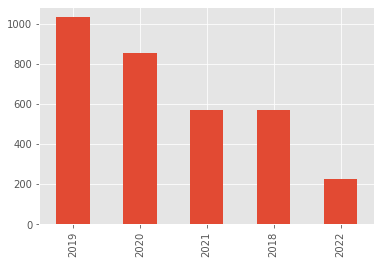

In [16]:
Aris['text'] = Aris['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")
Aris['year'].value_counts().plot(kind='bar')

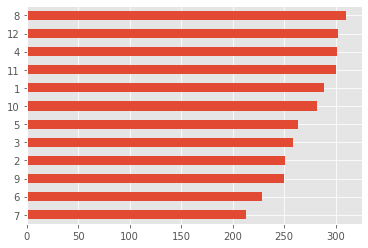

In [17]:
Aris['month'].value_counts().sort_values(ascending=True).plot(kind='barh')


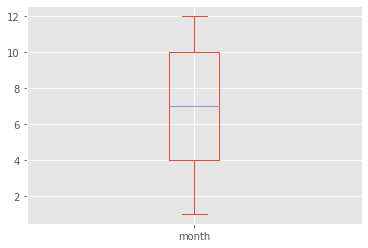

In [18]:
Aris['month'].plot(kind='box')

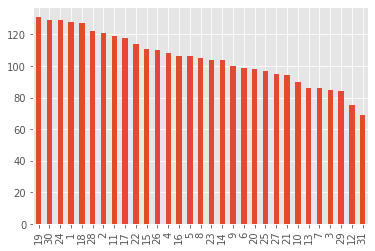

In [19]:
Aris['day'].value_counts().plot(kind='bar')

In [20]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

In [21]:
Aris[Aris['year']==2022]['text']

0      Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...
1      Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...
2      Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...
3      Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...
4      @GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...
                             ...                        
220    Οι ουγκανικές βρισιές συνιστούν πλέον διάλογο ...
221    Σοβαροί πολίτες συνιστούν σοβαρούς πολιτικούς ...
222    @TasosMalamas @myrtozax @ArisZachos @AkiPapazo...
223    Όταν ο Α. Ταίπρας (μας) δείχνει, με την ανακοί...
224    Και τώρα, στην αρχή της νέας Χρονιάς,\nΗ Κυβέρ...
Name: text, Length: 225, dtype: object

In [22]:
# Ισως καποτε χρειαστεί να αφαιρέσουμε τους τόνους.....
text = Aris['text'].str.replace('ά','α').str.replace("έ", "ε").str.replace('ή','η').str.replace('ί','ι').str.replace('ό','ο').str.replace('ύ','υ').str.replace('ώ','ω')

In [23]:
text = Aris[Aris['year']==2020]['text'].str.cat(sep = '.').replace("amp", ' ')
text

'Είπαμε, Μητσοτάκης κ κυβέρνηση έχουν έναν αντίπαλο:\nΤον εαυτό τους.\nΝαυάγησαν (ξανά) σε μια κουταλιά με τον εμβόλιμο εμβολιασμό.\nΌμως, να αντιδρούν οι ΣΥΡΙΖΑίοι που μέχρι χθες αρνούνταν την ύπαρξη εμβολίου σημαίνει εκτός από κωμωδία κ\nαντιπολίτευση για τα μπάζα...@TasosMalamas @SakisGontsis @liberalgreek @ArisZachos @Athanasiosfara1 @NikoSpagopoulos @johnkanellopo @AkiPapazoglou @peristeraRa @myrtozax @s_ntornta @CMouroutis @fontasts @gpapageorgiadis @AdonisGeorgiadi @ManolidouE @LKousoulis Δεν κλείνει απλώς ένας κακός χρόνος, κλείνει κ η δεκαετία.\nΑς θυμηθούμε τι ζήσαμε!\nΚαι εκεί που λέγαμε ότι θα πάρουμε μια ανάσα πλάκωσαν Ερντογάν κ κορονοϊός.\nΣυνεχίζουμε τη δύσκολη προσπάθεια ΟΛΟΙ ΜΑΖΙ.\nΚαλή Χρονιά να έχουμε αδέλφια της διαδικτυακής παρέας.\nΚαλημέρα σας..Το μάζεψε ο Πρωθυπουργός:\nΔεν θα πληρώνουν οι χαμηλοσυνταξιούχοι τα φάρμακα,που τους είχε δοθεί ως αντιστάθμισμα για την περικοπή του ΕΚΑΣ από τον Τσίπρα.\nΚακώς όμως χάθηκε η ευκαιρία να το ανακοινώσει εκ των προτέρων\n

In [24]:
list(STOPWORDS)[0:20]

['between',
 'her',
 'their',
 'whom',
 'below',
 "don't",
 'those',
 'can',
 "he'll",
 'get',
 'after',
 'are',
 'few',
 "how's",
 'yourselves',
 'further',
 'also',
 "why's",
 "didn't",
 'herself']

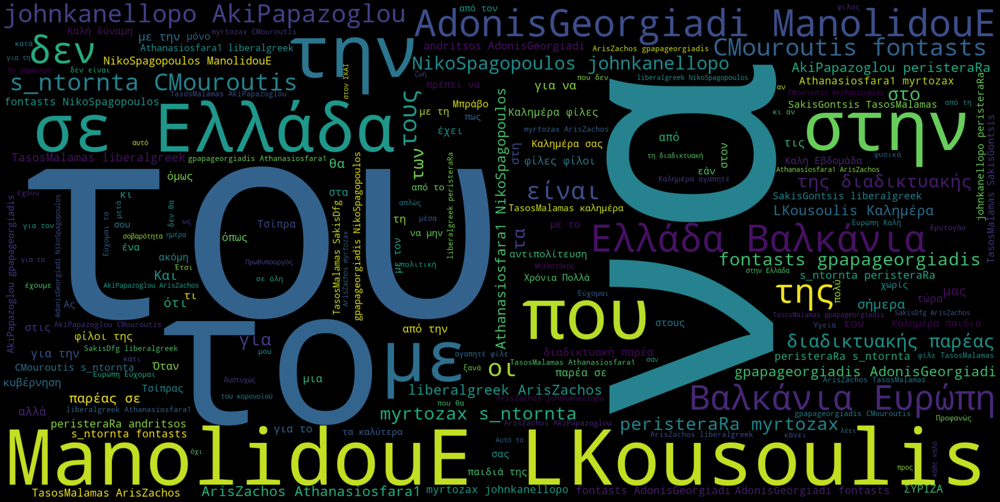

In [25]:
wordcloud = WordCloud(
#   stopwords = STOPWORDS,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [26]:
import spacy
!python -m spacy download el_core_news_sm


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.6 MB 5.5 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')


In [27]:
nlp = spacy.load('el_core_news_sm')
list(nlp.Defaults.stop_words)[0:20]

['λόγω',
 'ορισμένα',
 'όλες',
 'νωρίς',
 'όσοι',
 'πάνω',
 'συχνής',
 'εύγε',
 'ίδιων',
 'οποιανδήποτε',
 'κάμποσους',
 'τού',
 'τελευταία',
 'τούς',
 'στο',
 'ετέρων',
 'εναντίον',
 'οσηνδήποτε',
 'όποιο',
 'κάποιας']

In [28]:
text = Aris['text'].str.cat(sep = '.').replace('.','').strip()
text = text.replace('amp','').strip()
text = text.replace('rt','').strip()
text = text.replace('\n','').strip()
text = text.replace(':','').strip()
text

'Άλλος ένας μήνας με τις δημοσκοπήσεις να μην καταγράφουν την υπεροχή του ΣΥΡΙΖΑ!Πόσο στραβά αρμενίζει αυτή η κοινωνίαΣύντροφοι, μην το βάζετε κάτω, κερδάμεΕάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το 2019, όσο ήταν φρέσκια η Κυβέρνηση,τη σύσταση διακομματικής επιτροπής καταγραφής -και μόνο- των τυχοδιωκτικών ενεργειών του ΣΥΡΙΖΑ το 2015,Τώρα, τα πάντα θα αντιμετωπίζονταν με σοβαρότηταΑς ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαριστώ» προς τον Ερντογάν!Τέτοια υπερπροσπάθεια ούτε από φίλουςΓιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος του Σουνίου;Θα μπορούσε να το κόψει ποδαράτο από τις Πρέσπες, είναι πιο κοντά!Καθώς το 2015 το Αιγαίο δεν είχε σύνορα κατά τον Α Τσίπρα, αποδεικνύει, τώρα, πόσο του λείπει ο ΚαμμένοςΤον κρατά φυλαχτό όπως κ τον Πολάκη@GeorgiadouL @ArisZachos @TasosMalamas @AkiPapazoglou @myozax @peristeraRa @Athanasiosfara1 @SakisGontsis @liberalgreek @NikoSpagopoulos @johnkanellopo @s_ntornta @CMouroutis @fontasts @gpapageorgiadis @AdonisGeorgiadi @ManolidouE @LKousoulis 

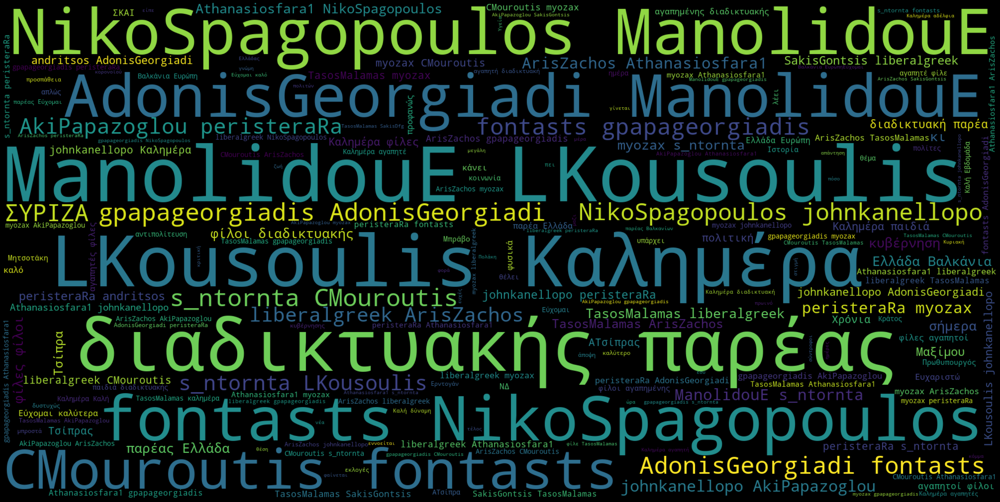

In [29]:

wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [30]:
from PIL import Image
import numpy as np

In [31]:
doc = nlp(Aris['text'][1])

In [32]:
for token in doc:
    print(token, token.lemma_)

Εάν αν
η ο
πλειοψηφία πλειοψηφία
στο σε ο
Κοινοβούλιο κοινοβούλιο
προωθούσε προωθώ
το ο
2019 2019
, ,
όσο όσο
ήταν είμαι
φρέσκια φρέσκια
η ο
Κυβέρνηση κυβέρνηση
, ,

 

τη ο
σύσταση σύσταση
διακομματικής διακομματικός
επιτροπής επιτροπή
καταγραφής καταγραφή
-και -και
μόνο μόνο
- -
των ο
τυχοδιωκτικών τυχοδιωκτικός
ενεργειών ενεργειών
του ο
ΣΥΡΙΖΑ ΣΥΡΙΖΑ
το ο
2015 2015
, ,

 

Τώρα Τώρα
, ,
τα ο
πάντα πάντα
θα θα
αντιμετωπίζονταν αντιμετωπίζω
με με
σοβαρότητα σοβαρότητα
.. ..


In [33]:
' '.join(token.lemma_ for token in doc)

'αν ο πλειοψηφία σε ο κοινοβούλιο προωθώ ο 2019 , όσο είμαι φρέσκια ο κυβέρνηση , \n ο σύσταση διακομματικός επιτροπή καταγραφή -και μόνο - ο τυχοδιωκτικός ενεργειών ο ΣΥΡΙΖΑ ο 2015 , \n Τώρα , ο πάντα θα αντιμετωπίζω με σοβαρότητα ..'

In [34]:
text

'Άλλος ένας μήνας με τις δημοσκοπήσεις να μην καταγράφουν την υπεροχή του ΣΥΡΙΖΑ!Πόσο στραβά αρμενίζει αυτή η κοινωνίαΣύντροφοι, μην το βάζετε κάτω, κερδάμεΕάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το 2019, όσο ήταν φρέσκια η Κυβέρνηση,τη σύσταση διακομματικής επιτροπής καταγραφής -και μόνο- των τυχοδιωκτικών ενεργειών του ΣΥΡΙΖΑ το 2015,Τώρα, τα πάντα θα αντιμετωπίζονταν με σοβαρότηταΑς ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαριστώ» προς τον Ερντογάν!Τέτοια υπερπροσπάθεια ούτε από φίλουςΓιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος του Σουνίου;Θα μπορούσε να το κόψει ποδαράτο από τις Πρέσπες, είναι πιο κοντά!Καθώς το 2015 το Αιγαίο δεν είχε σύνορα κατά τον Α Τσίπρα, αποδεικνύει, τώρα, πόσο του λείπει ο ΚαμμένοςΤον κρατά φυλαχτό όπως κ τον Πολάκη@GeorgiadouL @ArisZachos @TasosMalamas @AkiPapazoglou @myozax @peristeraRa @Athanasiosfara1 @SakisGontsis @liberalgreek @NikoSpagopoulos @johnkanellopo @s_ntornta @CMouroutis @fontasts @gpapageorgiadis @AdonisGeorgiadi @ManolidouE @LKousoulis 

In [35]:
full_doc = nlp(text)

In [36]:
clear_text = ' '.join(token.lemma_ for token in full_doc)

In [37]:
clear_text[200:400]

'όσο είμαι φρέσκια ο κυβέρνηση , ο σύσταση διακομματικός επιτροπή καταγραφή -και μόνο - ο τυχοδιωκτικός ενεργειών ο ΣΥΡΙΖΑ ο 2015,Τώρα , ο πάντα θα αντιμετωπίζονταν με σοβαρότηταΑς ακουστεί , επιτέλους'

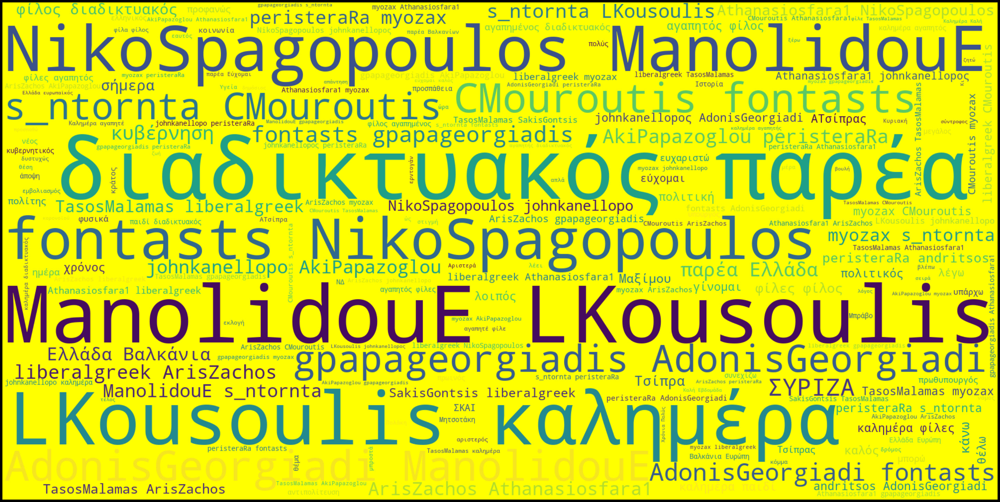

In [38]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'yellow'
 ).generate(clear_text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [39]:
from collections import Counter
Counter(" ".join(Aris["text"]).split()).most_common(16)

[('κ', 2668),
 ('να', 1945),
 ('την', 1815),
 ('της', 1701),
 ('το', 1683),
 ('για', 1501),
 ('με', 1315),
 ('του', 1299),
 ('η', 1098),
 ('που', 993),
 ('@TasosMalamas', 940),
 ('ο', 937),
 ('τα', 878),
 ('@ArisZachos', 872),
 ('@liberalgreek', 857),
 ('από', 854)]

In [40]:
for word in nlp.Defaults.stop_words:
  print(word)
  break

λόγω


In [41]:
Aris['text_no_stopwords'] = Aris['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words) and word != ':' and word != '\n' and word != "amp" and word != 'rt' and word != ',']))
Aris['text_no_stopwords'] = Aris['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words)]))
Aris['clean_text_no_stopwords'] = Aris['text']
#for stopword in nlp.Defaults.stop_words:
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: ' '.join([word for word in x.split() if word not in nlp.Defaults.stop_words and word != "ή" and word != "ία" and word != "κι"]))
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace("amp", "").strip())
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace("rt", "").strip())
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace(":", "").strip())
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace(",", "").strip())
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace("\n", "").strip())
Aris['clean_text_no_stopwords'] = Aris['clean_text_no_stopwords'].apply(lambda x: x.replace(".", "").strip())


In [42]:
freq = Counter(" ".join(Aris["clean_text_no_stopwords"]).split()).most_common(16)
freq

[('κ', 2681),
 ('@TasosMalamas', 1045),
 ('@ArisZachos', 924),
 ('@liberalgreek', 899),
 ('Καλημέρα', 852),
 ('@gpapageorgiadis', 841),
 ('@AdonisGeorgiadi', 840),
 ('@Athanasiosfara1', 829),
 ('@CMouroutis', 824),
 ('@myozax', 822),
 ('@peristeraRa', 816),
 ('@ManolidouE', 809),
 ('@LKousoulis', 809),
 ('@NikoSpagopoulos', 808),
 ('@s_ntornta', 808),
 ('@fontasts', 808)]

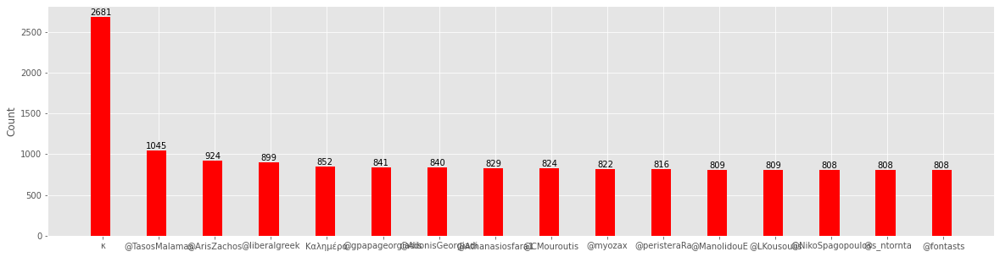

In [43]:
names, values = zip(*freq)
# names = [x[0] for x in data]  # These two lines are equivalent to the the zip-command.
# values = [x[1] for x in data] # These two lines are equivalent to the the zip-command.

ind = np.arange(len(freq))  # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots(figsize=(20,5))
rects1 = ax.bar(ind, values, width, color='r')
# add some text for labels, title and axes ticks
ax.set_ylabel('Count')
ax.set_xticks(ind+width/10.)
ax.set_xticklabels(names)

def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)

plt.show()

# Vectorizing Arisdf



In [44]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()

In [45]:
count_vector = cv.fit_transform(Aris['text'])

In [46]:
count_vector.shape

(3250, 16368)

In [47]:
cv.get_feature_names()

results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,000,000πχ,013,046,05,06,08,09,0ukxfb7ynnrgsto,...,ύψος,ώθηση,ώπα,ώρα,ώρας,ώρες,ώριμη,ώριμο,ώριμου,ώστε
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [48]:
#cv.vocabulary_

In [49]:
cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95)

In [50]:
count_vector = cv.fit_transform(Aris['text'])

In [51]:
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,09,10,100,1η,2015,60,adonisgeorgiadi,akipapazoglou,andritsos,...,φίλε,φίλες,φίλοι,φίλος,φαίνεται,φορά,φυσικά,χριστούγεννα,χρόνια,ώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,0


In [52]:
from html import unescape
def my_tokenizer(doc):
            
    # apply the preprocessing and tokenzation steps
    doc_clean = unescape(doc).lower()
    tokens = nlp(doc_clean)
    lemmatized_tokens = [token.lemma_ for token in tokens if (len(str(token.lemma_))>2)]
            
    # use CountVectorizer's _word_ngrams built in method
    # to remove stop words and extract n-grams
    return(lemmatized_tokens)

In [53]:
 cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95, tokenizer=my_tokenizer)
 count_vector = cv.fit_transform(Aris['text'])
 results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
 results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['έκασε ο', 'έτερα', 'έτερων', 'ήσω', 'ίσιος', 'αλλιώ', 'αλλιώτικος', 'αλλοιώ', 'αρκετός', 'γίνομαι', 'γρήγορο', 'διο', 'είχος', 'εαυτής', 'εαυτός', 'εκάστος', 'επόμενος', 'εσένος', 'ετέραις', 'ετού', 'ετούε ο', 'εχτής', 'ιδίο', 'κάνενς', 'κάνω', 'κανενό', 'λοιπός', 'μέλλω', 'μερικός', 'μπορώ', 'μόνας', 'ολωσδιόλος', 'ορισμένος', 'οριόμενσς', 'ποία', 'πολύς', 'προτός', 'προχτής', 'σε ο', 'ταύ', 'τουλάχισε ο', 'τρίτος', 'τός', 'χωριστό'] not in stop_words.
  % sorted(inconsistent)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,"0,60",09:00,"100,3",1ος,@adonisgeorgiadi,@akipapazoglou,@andritsos,@ariszachos,@athanasiosfara1,@cmouroutis,...,φίλε,φίλες,φίλος,φαίνομαι,φορά,φυσικά,χριστούγεννα,χρόνος,χώρα,ώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0


In [54]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Aris['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,adonisgeorgiadi,akipapazoglou,ariszachos,athanasiosfara1,cmouroutis,fontasts,gpapageorgiadis,johnkanellopo,liberalgreek,lkousoulis,manolidoue,myrtozax,nikospagopoulos,peristerara,s_ntornta,tasosmalamas,διαδικτυακής,ελλάδα,καλημέρα,παρέας
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,1


In [55]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, token_pattern = '\\αρης[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Aris['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,αρης
0,0
1,0
2,0
3,0
4,0


In [56]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, ngram_range=(2, 2) ) #token_pattern = '\\bαρης[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Aris['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,adonisgeorgiadi fontasts,adonisgeorgiadi manolidoue,akipapazoglou peristerara,ariszachos athanasiosfara1,athanasiosfara1 nikospagopoulos,cmouroutis fontasts,fontasts gpapageorgiadis,fontasts nikospagopoulos,gpapageorgiadis adonisgeorgiadi,johnkanellopo akipapazoglou,liberalgreek ariszachos,lkousoulis καλημέρα,manolidoue lkousoulis,manolidoue s_ntornta,nikospagopoulos johnkanellopo,nikospagopoulos manolidoue,peristerara myrtozax,s_ntornta cmouroutis,s_ntornta lkousoulis,διαδικτυακής παρέας
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,1,1,0,1,0,0,1,1,0,1,0,0,1,0,1


In [57]:
results.sum(axis =0).sort_values(ascending = False)

manolidoue lkousoulis              508
διαδικτυακής παρέας                490
lkousoulis καλημέρα                435
nikospagopoulos manolidoue         424
fontasts nikospagopoulos           405
adonisgeorgiadi manolidoue         382
cmouroutis fontasts                352
gpapageorgiadis adonisgeorgiadi    349
s_ntornta cmouroutis               342
adonisgeorgiadi fontasts           333
nikospagopoulos johnkanellopo      322
fontasts gpapageorgiadis           314
akipapazoglou peristerara          308
s_ntornta lkousoulis               298
liberalgreek ariszachos            281
johnkanellopo akipapazoglou        274
ariszachos athanasiosfara1         264
peristerara myrtozax               263
manolidoue s_ntornta               260
athanasiosfara1 nikospagopoulos    256
dtype: int64

In [58]:
sum_words =  results.sum(axis =0)
sum_words.sort_values(ascending = False).head() 

manolidoue lkousoulis         508
διαδικτυακής παρέας           490
lkousoulis καλημέρα           435
nikospagopoulos manolidoue    424
fontasts nikospagopoulos      405
dtype: int64

In [59]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
 #                    token_pattern = '(\\bαρης[οω]ρ[οω]ν[α-ωά-ώ]+\\b') )\| (\\bαρης[α-ωά-ώ]\\b) #, tokenizer=my_tokenizer)
                     token_pattern = '\\bcov[a-z0-9-_]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Aris['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,covid
0,0
1,0
2,0
3,0
4,0


In [60]:
results.sum(axis =0).sort_values(ascending = False)

covid    1
dtype: int64

In [61]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
                     vocabulary = ['Νεα Δημοκρατια', 'Συριζα', 'Εκλογες']) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Aris['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Νεα Δημοκρατια,Συριζα,Εκλογες
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0


In [62]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [63]:
tfidf_vectorizer = TfidfVectorizer(stop_words= nlp.Defaults.stop_words, max_features=500)
tfidf_matrix_train = tfidf_vectorizer.fit_transform(Aris['text'])  #finds the tfidf score with normalization

In [64]:
results = pd.DataFrame(tfidf_matrix_train.toarray(), columns=tfidf_vectorizer.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,08,09,10,100,11,12,15,19,19chdim61,...,χρόνων,χώρα,χώρες,ψέμα,ψέματα,ψήφισαν,ψυχραιμία,όμορφη,όνομα,ώρα
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [65]:
from sklearn.metrics.pairwise import cosine_similarity

print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train[0:1], tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.08636237 0.         ... 0.         0.         0.        ]]


In [66]:
print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train, tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements

cosine scores ==>  [[1.         0.08636237 0.         ... 0.         0.         0.        ]
 [0.08636237 1.         0.         ... 0.         0.         0.        ]
 [0.         0.         1.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 1.         0.97460184 0.43969909]
 [0.         0.         0.         ... 0.97460184 1.         0.45115766]
 [0.         0.         0.         ... 0.43969909 0.45115766 1.        ]]


In [67]:
arr = cosine_similarity(tfidf_matrix_train, tfidf_matrix_train)

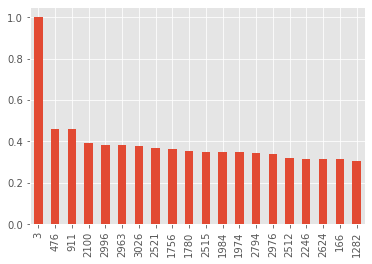

In [68]:
pd.DataFrame(arr).loc[3].sort_values(ascending = False).head(20).plot(kind = 'bar')

In [69]:
Aris['text'].loc[3]

'Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος του Σουνίου;\nΘα μπορούσε να το κόψει ποδαράτο από τις Πρέσπες, είναι πιο κοντά!\nΚαθώς το 2015 το Αιγαίο δεν είχε σύνορα κατά τον Α. Τσίπρα, αποδεικνύει, τώρα, πόσο του λείπει ο Καμμένος.\nΤον κρατά φυλαχτό όπως κ τον Πολάκη..'

In [70]:
Aris['text'].loc[2823]

'@TasosMalamas @CMouroutis @myrtozax @Athanasiosfara1 @liberalgreek @ArisZachos @peristeraRa @gpapageorgiadis @AdonisGeorgiadi @fontasts @NikoSpagopoulos @ManolidouE @s_ntornta @LKousoulis @johnkanellopo Καλημέρα Τάσο..ξυπνητήρι, αγαπητές φίλες, αγαπητοί φίλοι της διαδικτυακής παρέας.\nΚάθε καλό για την ημέρα σας: Υγεία, προσπάθεια, προκοπή! Τα καλύτερα έρχονται..\nΣτα λοιπά: Κυβερνητική αμηχανία παντού! Δεν καταλαβαίνουν από που τους έρχεται..'

# Emolex Arisdf

In [71]:
filepath = "https://raw.githubusercontent.com/datajour-gr/Data_journalism/master/week10/NRC_GREEK_Translated_6_2020.csv"
emolex_df = pd.read_csv(filepath)
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [72]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13166,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13167,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13168,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [73]:
emolex_df = emolex_df.drop_duplicates(subset=['word'])
emolex_df = emolex_df.dropna()
emolex_df.reset_index(drop = True, inplace = True)

In [74]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13157,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13158,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13159,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13160,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [75]:
import spacy
nlp = spacy.load('el_core_news_sm')

In [76]:
Aris_tweets_df = pd.read_csv("/content/gdrive/My Drive/Colab Notebooks/Aris.tsv", sep='\t')

In [77]:
len(Aris_tweets_df)

3250

In [78]:
short_tweets_Aris = Aris_tweets_df[['created_at','full_text' ]]
short_tweets_Aris = short_tweets_Aris.rename(columns={'created_at': 'date', 'full_text': 'text'} )

In [79]:
short_tweets_Aris.tail()

,date,text
3245,Tue Aug 14 06:17:42 +0000 2018,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...
3246,Tue Aug 14 06:15:23 +0000 2018,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ..."
3247,Tue Aug 14 06:07:45 +0000 2018,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...
3248,Tue Aug 14 06:07:07 +0000 2018,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...
3249,Tue Aug 14 05:49:55 +0000 2018,@AdonisGeorgiadi @liberalgreek @ArisZachos @At...


In [80]:
short_tweets_Aris.dtypes

date    object
text    object
dtype: object

In [81]:
short_tweets_Aris['date'] = pd.to_datetime(short_tweets_Aris['date'], format='%a %b %d %H:%M:%S +0000 %Y')

In [82]:
short_tweets_Aris['year'] = pd.DatetimeIndex(short_tweets_Aris['date']).year
short_tweets_Aris['month'] = pd.DatetimeIndex(short_tweets_Aris['date']).month
short_tweets_Aris['day'] = pd.DatetimeIndex(short_tweets_Aris['date']).day
short_tweets_Aris

,date,text,year,month,day
0,2022-07-06 18:39:38,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,2022,7,6
1,2022-07-05 09:14:43,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,2022,7,5
2,2022-07-03 20:27:17,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",2022,7,3
3,2022-07-01 04:19:02,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,2022,7,1
4,2022-07-01 03:56:35,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,2022,7,1
...,...,...,...,...,...
3245,2018-08-14 06:17:42,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...,2018,8,14
3246,2018-08-14 06:15:23,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ...",2018,8,14
3247,2018-08-14 06:07:45,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...,2018,8,14
3248,2018-08-14 06:07:07,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...,2018,8,14


In [83]:
short_tweets_Aris.dtypes

date     datetime64[ns]
text             object
year              int64
month             int64
day               int64
dtype: object

In [84]:
emolex_df['word'].head(3)

0              αφεση
1    ενορκη βεβαιωση
2            εχοντας
Name: word, dtype: object

In [85]:
short_tweets_Aris['text'] = short_tweets_Aris['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


In [86]:
short_tweets_Aris.head()

,date,text,year,month,day
0,2022-07-06 18:39:38,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,2022,7,6
1,2022-07-05 09:14:43,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,2022,7,5
2,2022-07-03 20:27:17,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",2022,7,3
3,2022-07-01 04:19:02,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,2022,7,1
4,2022-07-01 03:56:35,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,2022,7,1


In [87]:
vec = CountVectorizer(analyzer = 'word', vocabulary = emolex_df.word, 
                      strip_accents = 'unicode',  
                      stop_words= nlp.Defaults.stop_words,
                      ngram_range=(1, 2))

In [88]:
#from sklearn.feature_extraction.text import TfidfVectorizer
#CountVectorizer(stop_words='english', binary=True)
# Θέλω να ελέγξω μόνο τις λέξεις που υπάρχουν στο συναισθηματικό λεξικό

#CountVectorizer(analyzer = 'word', 
#              strip_accents = 'unicode', 
#               token_pattern='[Α-Ωα-ωΆ-Ώά-ώ]{2,}', 
#               stop_words= lc_stop_words_df['stop_w'].tolist())


matrix = vec.fit_transform(short_tweets_Aris['text'])
vocab = vec.get_feature_names()
wordcount_df = pd.DataFrame(matrix.toarray(), columns=vocab)
wordcount_df.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['αδιακοπα', 'ακομα', 'ακομη', 'ακριβως', 'αλλα', 'αλλαχου', 'αλλες', 'αλλη', 'αλλην', 'αλλης', 'αλλιως', 'αλλιωτικα', 'αλλο', 'αλλοι', 'αλλοιως', 'αλλοιωτικα', 'αλλον', 'αλλος', 'αλλοτε', 'αλλου', 'αλλους', 'αλλων', 'αμα', 'αμεσα', 'αμεσως', 'ανα', 'αναμεσα', 'αναμεταξυ', 'ανευ', 'αντι', 'αντιπερα', 'αντις', 'ανω', 'ανωτερω', 'αξαφνα', 'απεναντι', 'απο', 'αποψε', 'αρα', 'αραγε', 'αρκετα', 'αρκετες', 'αρχικα', 'αυριο', 'αυτα', 'αυτες', 'αυτη', 'αυτην', 'αυτης', 'αυτο', 'αυτοι', 'αυτον', 'αυτος', 'αυτου', 'αυτους', 'αυτων', 'αφοτου', 'αφου', 'βεβαια

,αφεση,ενορκη βεβαιωση,εχοντας,εχω,οριο,ορμος,υδρα,αγια τραπεζα,αμην,απατσι,...,κλητηριο ενταλμα,κατειργασμενος,μαγια,κιτρινο,κιτρινιζω,ουρλιασμα,κροκος αυγου,νεοτερος,ζεφυρος,ζουμ
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [89]:
wordcount_df.shape

(3250, 13161)

In [90]:
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [91]:
emolex_df[emolex_df.Anger == 1].tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13094,διεξοδος,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13096,ζωυφια,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
13100,θυματοποιω,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0
13128,αποτυχημενος,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [92]:
# Φτιάξε μια λίστα με positive words

angry_words = emolex_df[emolex_df.Anger == 1]['word']

positive_words = emolex_df[emolex_df.Positive == 1]['word']


# Φτιάξε μια λίστα με sadness words
sadness_words = emolex_df[emolex_df.Sadness == 1]['word']


# Φτιάξε μια λίστα με surprise words
surprise_words = emolex_df[emolex_df.Surprise == 1]['word']


# Φτιάξε μια λίστα με disgust words
disgust_words = emolex_df[emolex_df.Disgust == 1]['word']


# Φτιάξε μια λίστα με anticipation words
anticipation_words = emolex_df[emolex_df.Anticipation == 1]['word']


# Φτιάξε μια λίστα με negative words
negative_words = emolex_df[emolex_df.Negative == 1]['word']



# Φτιάξε μια λίστα με joy words
joy_words = emolex_df[emolex_df.Joy == 1]['word']


# Φτιάξε μια λίστα με trust words
trust_words = emolex_df[emolex_df.Trust == 1]['word']



# Φτιάξε μια λίστα με fear words
fear_words = emolex_df[emolex_df.Fear == 1]['word']


In [93]:
short_tweets_Aris.head(3)

,date,text,year,month,day
0,2022-07-06 18:39:38,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,2022,7,6
1,2022-07-05 09:14:43,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,2022,7,5
2,2022-07-03 20:27:17,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",2022,7,3


In [94]:
short_tweets_Aris['anger'] = wordcount_df[angry_words].sum(axis=1)

short_tweets_Aris['positivity'] = wordcount_df[positive_words].sum(axis=1)


short_tweets_Aris['joy'] = wordcount_df[joy_words].sum(axis=1)


short_tweets_Aris['disgust'] = wordcount_df[disgust_words].sum(axis=1)



short_tweets_Aris['surprise'] = wordcount_df[surprise_words].sum(axis=1)

short_tweets_Aris['trust'] = wordcount_df[trust_words].sum(axis=1)


short_tweets_Aris['anticipation'] = wordcount_df[anticipation_words].sum(axis=1)


short_tweets_Aris['sadness'] = wordcount_df[sadness_words].sum(axis=1)

short_tweets_Aris['negative'] = wordcount_df[negative_words].sum(axis=1)

short_tweets_Aris['fear'] = wordcount_df[fear_words].sum(axis=1)


In [95]:
short_tweets_Aris

,date,text,year,month,day,anger,positivity,joy,disgust,surprise,trust,anticipation,sadness,negative,fear
0,2022-07-06 18:39:38,Άλλος ένας μήνας με τις δημοσκοπήσεις να μην κ...,2022,7,6,1,1,1,1,1,1,1,0,2,1
1,2022-07-05 09:14:43,Εάν η πλειοψηφία στο Κοινοβούλιο προωθούσε το ...,2022,7,5,0,3,1,0,0,4,0,1,2,2
2,2022-07-03 20:27:17,"Ας ακουστεί, επιτέλους, από Μαξίμου ένα «ευχαρ...",2022,7,3,0,0,0,0,0,0,0,0,0,0
3,2022-07-01 04:19:02,Γιατί να περπατήσει από Μαδρίτη ο ξάγρυπνος το...,2022,7,1,1,1,0,2,0,1,0,1,3,1
4,2022-07-01 03:56:35,@GeorgiadouL @ArisZachos @TasosMalamas @AkiPap...,2022,7,1,0,1,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3245,2018-08-14 06:17:42,@TasosMalamas @AdonisGeorgiadi @liberalgreek @...,2018,8,14,0,0,0,0,0,0,0,0,0,0
3246,2018-08-14 06:15:23,"Γιατί τόση φασαρία, σύντροφοι Μαξίμου, με την ...",2018,8,14,2,0,0,1,1,1,1,2,2,1
3247,2018-08-14 06:07:45,@NickolaosC @AdonisGeorgiadi @liberalgreek @Ar...,2018,8,14,0,0,0,0,0,0,0,0,0,0
3248,2018-08-14 06:07:07,@leoavger @AdonisGeorgiadi @liberalgreek @Aris...,2018,8,14,0,1,0,0,0,0,0,0,0,0


In [96]:
max = 0
happiest_tweet = ""
for i in range(0,len(short_tweets_Aris)):
  #print(short_tweets_Aris.iloc[i]['positivity'])
  if short_tweets_Aris.iloc[i]['positivity'] > max:
    happiest_tweet = short_tweets_Aris.iloc[i]['text']
    max = short_tweets_Aris.iloc[i]['positivity']


happiest_tweet

'ΧΡΟΝΙΑ ΠΟΛΛΑ. ΚΑΛΑ ΧΡΙΣΤΟΥΓΕΝΝΑ.\nΕύχομαι Υγεία, Αγάπη, Ειρήνη, Προσπάθεια, Ευημερία, ατομική κ συλλογική!\nΡαδιοφωνικό ραντεβού ανήμερα Χριστουγέννων 8-10 στον ΣΚΑΙ 100,3 με Τ. Θεοδωρόπουλο κ Μ. Κατσουνάκη.\nΠρωινό Πέμπτης την ίδια ώρα συζήτηση με Σ.Τριανταφύλλου.\nΣας περιμένω..'

In [97]:
max = 0
negative_tweet = ""
for i in range(0,len(short_tweets_Aris)):
  #print(short_tweets_Aris.iloc[i]['positivity'])
  if short_tweets_Aris.iloc[i]['negative'] > max:
    negative_tweet = short_tweets_Aris.iloc[i]['text']
    max = short_tweets_Aris.iloc[i]['negative']


negative_tweet

'Η Δικαιοσύνη με τη δίωξη σε βαθμό κακουργήματος σε βάρος των δύο ανηλίκων για τον ξυλοδαρμό του σταθμάρχη έπραξε το καθήκον της.\nΗ Πολιτεία πρέπει να ασχοληθεί με την ανάσχεση κ την εξάλειψη της βίας. \nΜε τη βία που εξαπλώνεται επικίνδυνα την τελευταία 10ετια!\nΧωρίς καθυστέρηση..'

In [98]:
max = 0
saddest_tweet = ""
for i in range(0,len(short_tweets_Aris)):
  #print(short_tweets_Aris.iloc[i]['positivity'])
  if short_tweets_Aris.iloc[i]['sadness'] > max:
    saddest_tweet = short_tweets_Aris.iloc[i]['text']
    max = short_tweets_Aris.iloc[i]['sadness']

saddest_tweet

'Τι ήταν να πει ο Α. Λοβέρδος ότι θα ψηφίσει τον Ν. Ανδρουλάκη.\nΤέτοια θλίψη, τόσος πόνος, πόση απελπισία,\nΑπλώθηκε στα μαρμαρένια αλώνια της Κουμουνδούρου!\nΑπό ναυάγιο σε ναυάγιο η «προοδευτική» συμμαχία..'

In [99]:
max = 0
fear_tweet = ""
for i in range(0,len(short_tweets_Aris)):
  #print(short_tweets_Aris.iloc[i]['positivity'])
  if short_tweets_Aris.iloc[i]['fear'] > max:
    fear_tweet = short_tweets_Aris.iloc[i]['text']
    max = short_tweets_Aris.iloc[i]['fear']

fear_tweet

'Η βία, η εγκληματικότητα, η τρομοκρατία αντιμετωπίζονται με αυστηρότητα στην αστυνόμευση κ τη δικαιοσύνη.\nΓια το μέγιστο κοινωνικό αγαθό της ασφάλειας δεν θα βρεθεί πολίτης (ανεξαρτήτως ποιο κόμμα ψηφίζει) να δηλώσει το αντίθετο.\nΗ κυβέρνηση οφείλει να μην είναι στον κόσμο της..'

In [100]:
max = 0
trust_tweet = ""
for i in range(0,len(short_tweets_Aris)):
  #print(short_tweets_Aris.iloc[i]['positivity'])
  if short_tweets_Aris.iloc[i]['trust'] > max:
    trust_tweet = short_tweets_Aris.iloc[i]['text']
    max = short_tweets_Aris.iloc[i]['trust']

trust_tweet

'Πράξη 1η:Η επίκληση του φιλότιμου.Ισως να μην αρκεί\nΠράξη 2η:Οι κανόνες.Εφαρμόστηκαν με επιτυχία\nΠράξη 3η:Οι ποινές,αρκεί να επιβάλλονται\nΑντιμετωπίζουν την απειθαρχία κ την ανοησία\nΗ κυβέρνηση ας μη φοβάται\nΣύσσωμη η αντιπολίτευση αδυνατεί να αποφασίσει τι πρέπει για κορονοϊό..'

In [101]:
short_tweets_Aris.set_index('date' , inplace=True)

In [102]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')

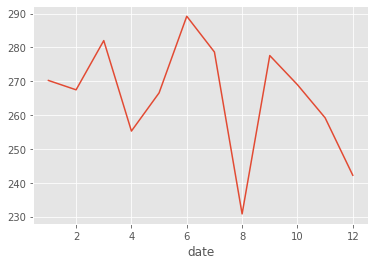

In [103]:
short_tweets_Aris['text'].str.len().groupby(by=short_tweets_Aris.index.month).mean().plot()

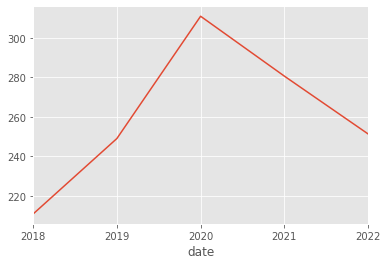

In [104]:
short_tweets_Aris['text'].str.len().resample('A').mean().plot() 

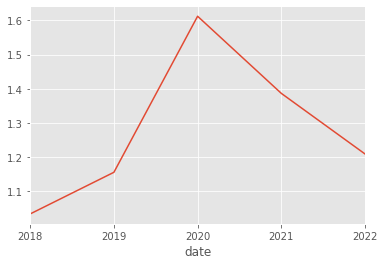

In [105]:
short_tweets_Aris['positivity'].resample('A').mean().plot() 

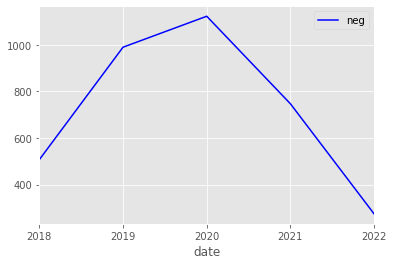

In [106]:
short_tweets_Aris['negative'].resample('A').sum().plot(color = 'b',label = 'neg').legend() 

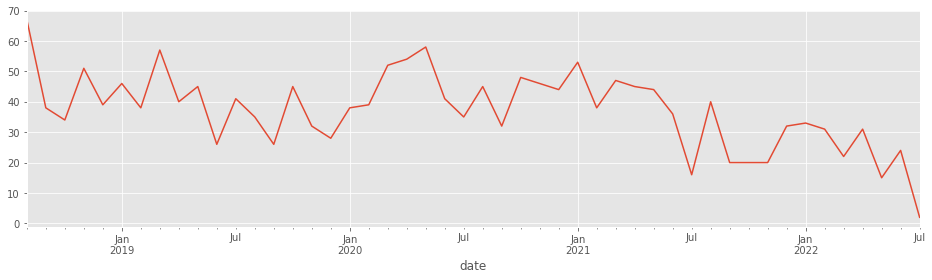

In [107]:
short_tweets_Aris['anger'].resample('M').sum().plot(figsize=(16,4))

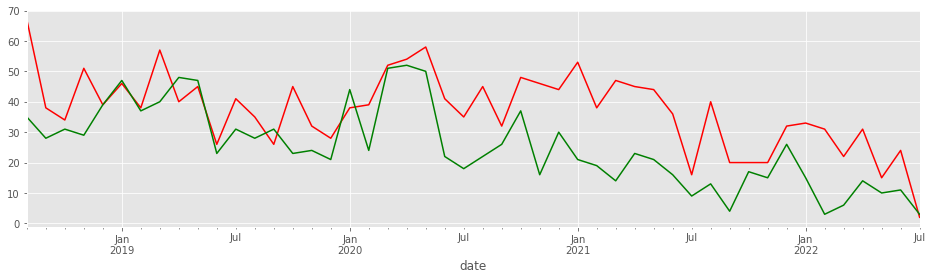

In [108]:
ax = short_tweets_Aris['anger'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Aris['joy'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')

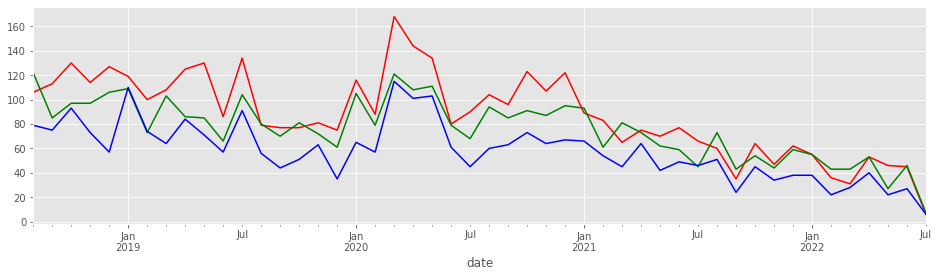

In [109]:
ax = short_tweets_Aris['positivity'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Aris['negative'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_Aris['trust'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'blue')

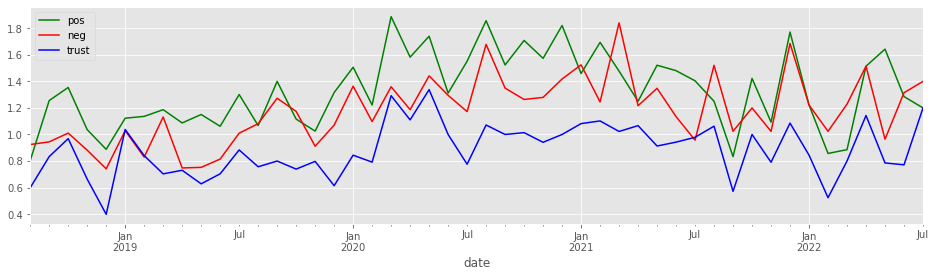

In [110]:
ax = short_tweets_Aris['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_Aris['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_Aris['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

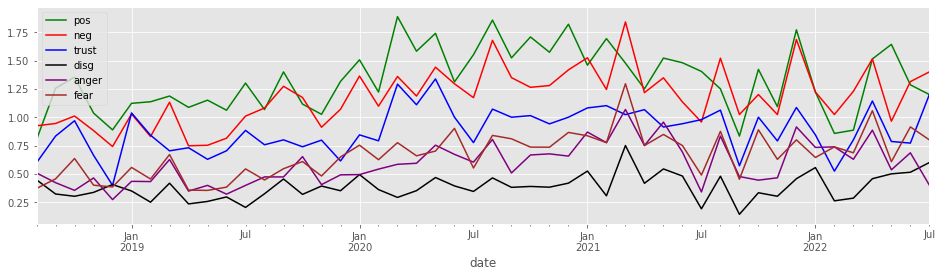

In [111]:
plt.style.use('ggplot')
ax = short_tweets_Aris['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_Aris['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_Aris['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

short_tweets_Aris['disgust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'disg',color = 'black').legend() 

short_tweets_Aris['anger'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'anger',color = 'purple').legend() 

short_tweets_Aris['fear'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'fear',color = 'brown').legend()    

Text(0, 0.5, 'Years')

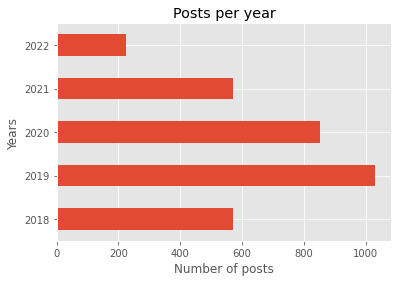

In [112]:
short_tweets_Aris['text'].groupby(by=short_tweets_Aris.index.year).count().plot(kind='barh')
plt.title("Posts per year")
plt.xlabel("Number of posts")
plt.ylabel("Years")

Text(0, 0.5, 'Month of the year')

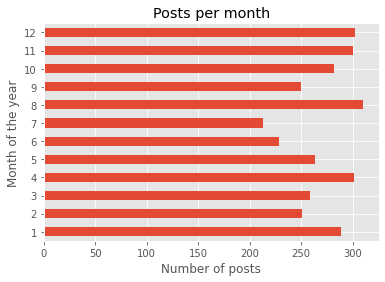

In [113]:
short_tweets_Aris['text'].groupby(by=short_tweets_Aris.index.month).count().plot(kind='barh')
plt.title("Posts per month")
plt.xlabel("Number of posts")
plt.ylabel("Month of the year")

Text(0, 0.5, 'Hour of the day')

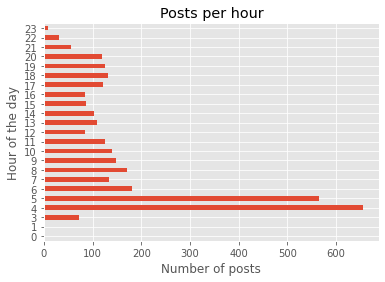

In [114]:
short_tweets_Aris['text'].groupby(by=short_tweets_Aris.index.hour).count().plot(kind='barh')
plt.title("Posts per hour")
plt.xlabel("Number of posts")
plt.ylabel("Hour of the day")

# Kostas Vaxevanis


In [115]:
Vax = []
try:
    user_timeline = twitter.get_user_timeline(screen_name='KostasVaxevanis',count=200, tweet_mode = 'extended'  )
except TwythonError as e:
    print("Error getting tweets:", e)
print("I Got:", len(user_timeline), " tweets")
for tweet in user_timeline:
    # Add whatever you want from the tweet, here we just add the text
    Vax.append(tweet)

I Got: 199  tweets


In [116]:
pd.DataFrame(Vax)

,created_at,id,id_str,full_text,truncated,display_text_range,entities,source,in_reply_to_status_id,in_reply_to_status_id_str,...,quoted_status_id_str,quoted_status_permalink,retweet_count,favorite_count,favorited,retweeted,lang,extended_entities,possibly_sensitive,quoted_status
0,Sun Jul 10 13:25:50 +0000 2022,1546123533763362818,1546123533763362818,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,False,"[0, 139]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546071167588605954,"{'url': 'https://t.co/081GhKaStT', 'expanded':...",5,0,False,False,el,NaN,NaN,NaN
1,Sun Jul 10 13:25:35 +0000 2022,1546123469057708037,1546123469057708037,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,False,"[12, 43]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",1.546097e+18,1546097090958327811,...,NaN,NaN,0,4,False,False,el,NaN,NaN,NaN
2,Sun Jul 10 13:24:22 +0000 2022,1546123162852769793,1546123162852769793,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,False,"[0, 106]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546096313141526529,"{'url': 'https://t.co/CrnPKEJI2n', 'expanded':...",9,0,False,False,el,NaN,NaN,NaN
3,Sun Jul 10 13:22:19 +0000 2022,1546122646143787008,1546122646143787008,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,False,"[0, 104]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546090898504687618,"{'url': 'https://t.co/PsQ8xvKNpC', 'expanded':...",9,0,False,False,el,NaN,NaN,NaN
4,Sun Jul 10 13:20:39 +0000 2022,1546122228399579138,1546122228399579138,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,False,"[0, 112]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,NaN,NaN,1,0,False,False,el,"{'media': [{'id': 1492904098055835652, 'id_str...",False,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194,Fri Jul 08 19:19:49 +0000 2022,1545487839948840964,1545487839948840964,RT @avgerinosx: Τους πάει μέχρι τέλους ο Βαξεβ...,False,"[0, 140]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,NaN,NaN,20,0,False,False,el,NaN,NaN,NaN
195,Fri Jul 08 19:19:42 +0000 2022,1545487810383200257,1545487810383200257,"RT @PanagiotoyP: Κύριε αντιπρόεδρε,σας ψάχνουν...",False,"[0, 89]","{'hashtags': [{'text': 'κυβερνηση_συμμορια', '...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1545473976968921088,"{'url': 'https://t.co/3o1MyhwvMh', 'expanded':...",4,0,False,False,el,NaN,NaN,NaN
196,Fri Jul 08 19:19:33 +0000 2022,1545487773037215745,1545487773037215745,"RT @kostasfy: Με συνέργεια Γεωργιάδη, ΕΥΠ και ...",False,"[0, 140]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,NaN,NaN,3,0,False,False,el,NaN,NaN,NaN
197,Fri Jul 08 19:19:18 +0000 2022,1545487710550429698,1545487710550429698,RT @andrikeloss: Εντάξει... Δεν έχω λόγια... Μ...,False,"[0, 109]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1545482578722955267,"{'url': 'https://t.co/AKVnvioehL', 'expanded':...",5,0,False,False,el,NaN,NaN,NaN


In [117]:
# Count could be less than 200, see:
# https://dev.twitter.com/discussions/7513
while len(user_timeline) != 0: 
    try:
        user_timeline = twitter.get_user_timeline(screen_name='KostasVaxevanis',count=100,
                                                  tweet_mode = 'extended', max_id=user_timeline[len(user_timeline)-1]['id']-1)
    except TwythonError as e:
        print("Error getting tweets:", e)
    if len(user_timeline) > 0:
        print("I Got:", len(user_timeline), " tweets more... Last ID:", user_timeline[len(user_timeline)-1]['id']-1)
    for tweet in user_timeline:
        # Add whatever you want from the tweet, here we just add the text
        Vax.append(tweet)
# Number of tweets the user has made
print("I got :", len(Vax), " in total!!!")

I Got: 100  tweets more... Last ID: 1545132023727247359
I Got: 100  tweets more... Last ID: 1544783643536752640
I Got: 100  tweets more... Last ID: 1544602861643960319
I Got: 100  tweets more... Last ID: 1544278541432389632
I Got: 100  tweets more... Last ID: 1544018743780589568
I Got: 100  tweets more... Last ID: 1543834587138297855
I Got: 100  tweets more... Last ID: 1543599366744821761
I Got: 100  tweets more... Last ID: 1543519100969914367
I Got: 100  tweets more... Last ID: 1543199428483350527
I Got: 100  tweets more... Last ID: 1542972592973283327
I Got: 100  tweets more... Last ID: 1542853406360051713
I Got: 100  tweets more... Last ID: 1542543466642784255
I Got: 100  tweets more... Last ID: 1541870212399742975
I Got: 100  tweets more... Last ID: 1540964556507422719
I Got: 100  tweets more... Last ID: 1540312629503311871
I Got: 100  tweets more... Last ID: 1539572220179136511
I Got: 100  tweets more... Last ID: 1538634721491664896
I Got: 99  tweets more... Last ID: 1538161871437

In [118]:
# Number of tweets the user has made
print("I got :", len(Vax), " in total!!!")
#len(Vax)

I got : 3244  in total!!!


In [119]:
for tweet in Vax:
    print(tweet['created_at'],tweet['full_text'])

Sun Jul 10 13:25:50 +0000 2022 RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υπουργό άλλης χώρας να απευθύνεται σε δημοσιογράφο (με ό,τι κι αν του έχει σύρει εκείνος) και…
Sun Jul 10 13:25:35 +0000 2022 @koskar2012 Κανένα πρόβλημα. Να τις δώσουμε
Sun Jul 10 13:24:22 +0000 2022 RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγαινα αν ήμουν καθαρός. 
ΑΝ ήμουν λέω . 
Πρόσεξε το ΑΝ ΗΜΟΥΝ .
Sun Jul 10 13:22:19 +0000 2022 RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σκάνδαλο και βρωμοδουλεια υπάρχει, απο κάτω είσαι εσύ Σπύρο
Sun Jul 10 13:20:39 +0000 2022 RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που κλεινει την ωραια εκπομπη @ANASKOPISI_TPP https://t.co/JgzZzmisqN
Sun Jul 10 13:05:01 +0000 2022 RT @LamprosNikos: Που είναι εκείνος ο Άδωνης που απειλούσε ότι θα έγδερνε,θα μήνυε..θα εξόντωνε..; Φοβάται μη γίνει στιφάδο..θα προσφέρουμε…
Sun Jul 10 12:13:14 +0000 2022 RT @LamprosNikos: Από το editorial του @KostasVaxevanis 
👍👍👍 https://t.co/Ni2a9BBRVb
Sun Jul 10 12:11:53 +0000 2022 RT @constads: Είν

In [120]:
#Vax[0]

In [121]:
Vax_df = pd.DataFrame(Vax)
Vax_df.head()

,created_at,id,id_str,full_text,truncated,display_text_range,entities,source,in_reply_to_status_id,in_reply_to_status_id_str,...,quoted_status_id_str,quoted_status_permalink,retweet_count,favorite_count,favorited,retweeted,lang,extended_entities,possibly_sensitive,quoted_status
0,Sun Jul 10 13:25:50 +0000 2022,1546123533763362818,1546123533763362818,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,False,"[0, 139]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546071167588605954,"{'url': 'https://t.co/081GhKaStT', 'expanded':...",5,0,False,False,el,NaN,NaN,NaN
1,Sun Jul 10 13:25:35 +0000 2022,1546123469057708037,1546123469057708037,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,False,"[12, 43]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",1.546097e+18,1546097090958327811,...,NaN,NaN,0,4,False,False,el,NaN,NaN,NaN
2,Sun Jul 10 13:24:22 +0000 2022,1546123162852769793,1546123162852769793,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,False,"[0, 106]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546096313141526529,"{'url': 'https://t.co/CrnPKEJI2n', 'expanded':...",9,0,False,False,el,NaN,NaN,NaN
3,Sun Jul 10 13:22:19 +0000 2022,1546122646143787008,1546122646143787008,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,False,"[0, 104]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,1546090898504687618,"{'url': 'https://t.co/PsQ8xvKNpC', 'expanded':...",9,0,False,False,el,NaN,NaN,NaN
4,Sun Jul 10 13:20:39 +0000 2022,1546122228399579138,1546122228399579138,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,False,"[0, 112]","{'hashtags': [], 'symbols': [], 'user_mentions...","<a href=""http://twitter.com/download/android"" ...",NaN,None,...,NaN,NaN,1,0,False,False,el,"{'media': [{'id': 1492904098055835652, 'id_str...",False,NaN


In [122]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [123]:
Vax_df.to_csv("/content/gdrive/My Drive/Colab Notebooks/Vax.tsv", sep='\t')

# Επεξεργασία Vaxdf

In [124]:
Vax = Vax_df[['created_at','full_text' ]]
Vax = Vax.rename(columns={'created_at': 'date', 'full_text': 'text'} )
Vax

,date,text
0,Sun Jul 10 13:25:50 +0000 2022,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...
1,Sun Jul 10 13:25:35 +0000 2022,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε
2,Sun Jul 10 13:24:22 +0000 2022,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...
3,Sun Jul 10 13:22:19 +0000 2022,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...
4,Sun Jul 10 13:20:39 +0000 2022,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...
...,...,...
3239,Thu Jun 02 20:31:11 +0000 2022,RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...
3240,Thu Jun 02 20:31:02 +0000 2022,RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...
3241,Thu Jun 02 20:29:54 +0000 2022,RT @TassosMorfis: Αυτά που γίνονται με το σκάν...
3242,Thu Jun 02 20:21:42 +0000 2022,RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...


In [125]:
#Vax.dtypes

In [126]:
Vax['year'] = pd.DatetimeIndex(Vax['date']).year
Vax['month'] = pd.DatetimeIndex(Vax['date']).month
Vax['day'] = pd.DatetimeIndex(Vax['date']).day
Vax

,date,text,year,month,day
0,Sun Jul 10 13:25:50 +0000 2022,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,2022,7,10
1,Sun Jul 10 13:25:35 +0000 2022,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,2022,7,10
2,Sun Jul 10 13:24:22 +0000 2022,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,2022,7,10
3,Sun Jul 10 13:22:19 +0000 2022,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,2022,7,10
4,Sun Jul 10 13:20:39 +0000 2022,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,2022,7,10
...,...,...,...,...,...
3239,Thu Jun 02 20:31:11 +0000 2022,RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...,2022,6,2
3240,Thu Jun 02 20:31:02 +0000 2022,RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...,2022,6,2
3241,Thu Jun 02 20:29:54 +0000 2022,RT @TassosMorfis: Αυτά που γίνονται με το σκάν...,2022,6,2
3242,Thu Jun 02 20:21:42 +0000 2022,RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...,2022,6,2


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


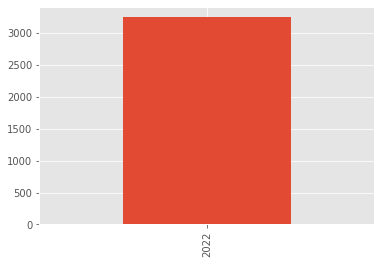

In [127]:
Vax['text'] = Vax['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")
Vax['year'].value_counts().plot(kind='bar')

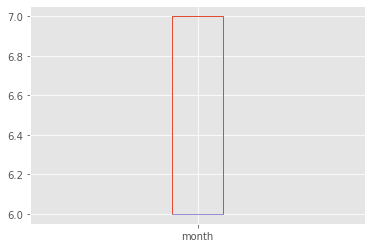

In [128]:
Vax['month'].plot(kind='box')

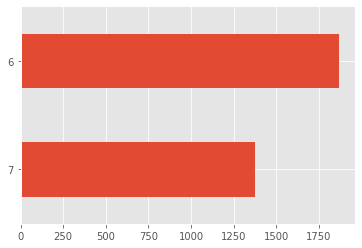

In [129]:
Vax['month'].value_counts().sort_values(ascending=True).plot(kind='barh')


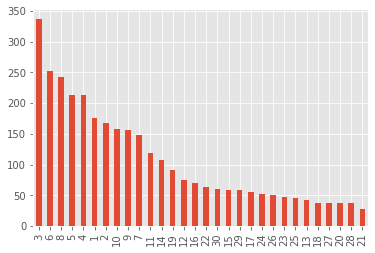

In [130]:
Vax['day'].value_counts().plot(kind='bar')

In [131]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

In [132]:
Vax[Vax['year']==2022]['text']

0       RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...
1             @koskar2012 Κανένα πρόβλημα. Να τις δώσουμε
2       RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...
3       RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...
4       RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...
                              ...                        
3239    RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...
3240    RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...
3241    RT @TassosMorfis: Αυτά που γίνονται με το σκάν...
3242    RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...
3243                                  RT @aeisixtir: 🤣🤣🤣🤣
Name: text, Length: 3244, dtype: object

In [133]:
# Ισως καποτε χρειαστεί να αφαιρέσουμε τους τόνους.....
text = Vax['text'].str.replace('ά','α').str.replace("έ", "ε").str.replace('ή','η').str.replace('ί','ι').str.replace('ό','ο').str.replace('ύ','υ').str.replace('ώ','ω')

In [134]:
text = Vax[Vax['year']==2022]['text'].str.cat(sep = '.').replace("amp", ' ')
text

'RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υπουργό άλλης χώρας να απευθύνεται σε δημοσιογράφο (με ό,τι κι αν του έχει σύρει εκείνος) και….@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε.RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγαινα αν ήμουν καθαρός. \nΑΝ ήμουν λέω . \nΠρόσεξε το ΑΝ ΗΜΟΥΝ ..RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σκάνδαλο και βρωμοδουλεια υπάρχει, απο κάτω είσαι εσύ Σπύρο.RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που κλεινει την ωραια εκπομπη @ANASKOPISI_TPP  .RT @L rosNikos: Που είναι εκείνος ο Άδωνης που απειλούσε ότι θα έγδερνε,θα μήνυε..θα εξόντωνε..; Φοβάται μη γίνει στιφάδο..θα προσφέρουμε….RT @L rosNikos: Από το editorial του @KostasVaxevanis \n👍👍👍  .RT @constads: Είναι ο Άδωνις το μεγαλύτερο σούργελο της μεταπολίτευσης;.Η επιχειρηματολογία είναι επιπέδου "έδωσα συστατική επιστολή στον Τούρκο μαφιόζο γιατί ήταν αντικαθεστωτικός". Όποιος τον είπε γελοία πατσαβούρα της Βέρμαχτ τον αδίκησε  .Επειδή δεν θέλουμε να αδικήσουμε τον Υπουργό, τον καλούμε για συνέ

In [135]:
list(STOPWORDS)[0:20]

['between',
 'her',
 'their',
 'whom',
 'below',
 "don't",
 'those',
 'can',
 "he'll",
 'get',
 'after',
 'are',
 'few',
 "how's",
 'yourselves',
 'further',
 'also',
 "why's",
 "didn't",
 'herself']

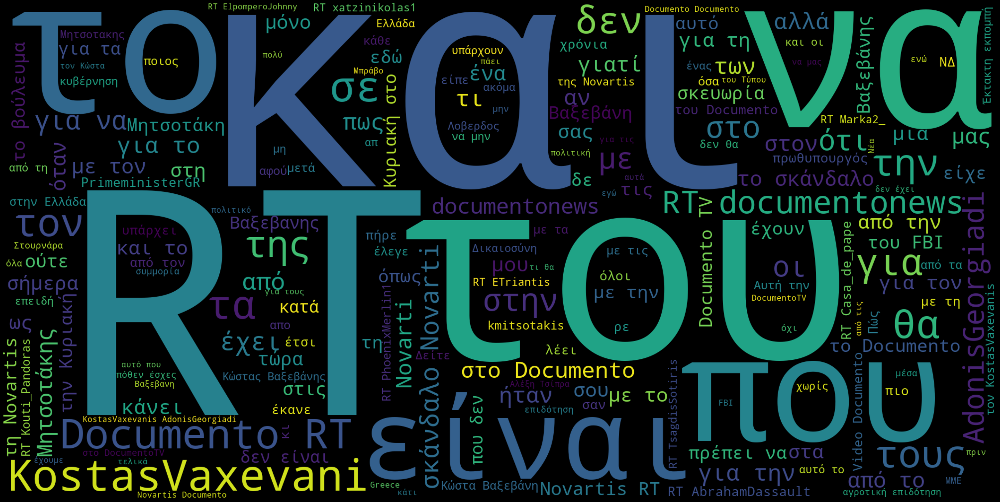

In [136]:
wordcloud = WordCloud(
#   stopwords = STOPWORDS,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [137]:
import spacy
!python -m spacy download el_core_news_sm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.6 MB 5.5 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('el_core_news_sm')


In [138]:
nlp = spacy.load('el_core_news_sm')

In [139]:
list(nlp.Defaults.stop_words)[0:20]

['λόγω',
 'ορισμένα',
 'όλες',
 'νωρίς',
 'όσοι',
 'πάνω',
 'συχνής',
 'εύγε',
 'ίδιων',
 'οποιανδήποτε',
 'κάμποσους',
 'τού',
 'τελευταία',
 'τούς',
 'στο',
 'ετέρων',
 'εναντίον',
 'οσηνδήποτε',
 'όποιο',
 'κάποιας']

In [140]:
text = Vax['text'].str.cat(sep = '.').replace('.','').strip()
text = text.replace('amp','').strip()
text = text.replace('rt','').strip()
text = text.replace('\n','').strip()
text = text.replace(':','').strip()
text

'RT @ti_psifisate_re Που θα δείτε ρε μαλάκες Υπουργό άλλης χώρας να απευθύνεται σε δημοσιογράφο (με ό,τι κι αν του έχει σύρει εκείνος) και…@koskar2012 Κανένα πρόβλημα Να τις δώσουμεRT @trakterogege Εγώ @AdonisGeorgiadi θα πήγαινα αν ήμουν καθαρός ΑΝ ήμουν λέω  Πρόσεξε το ΑΝ ΗΜΟΥΝ RT @_VaLhaLLa_2 Τι να απαντήσεις αφού οποίο σκάνδαλο και βρωμοδουλεια υπάρχει, απο κάτω είσαι εσύ ΣπύροRT @ant_autou Αδιευκρινιστος Το τραγουδι που κλεινει την ωραια εκπομπη @ANASKOPISI_TPP  RT @LrosNikos Που είναι εκείνος ο Άδωνης που απειλούσε ότι θα έγδερνε,θα μήνυεθα εξόντωνε; Φοβάται μη γίνει στιφάδοθα προσφέρουμε…RT @LrosNikos Από το editorial του @KostasVaxevanis 👍👍👍  RT @constads Είναι ο Άδωνις το μεγαλύτερο σούργελο της μεταπολίτευσης;Η επιχειρηματολογία είναι επιπέδου "έδωσα συστατική επιστολή στον Τούρκο μαφιόζο γιατί ήταν αντικαθεστωτικός" Όποιος τον είπε γελοία πατσαβούρα της Βέρμαχτ τον αδίκησε  Επειδή δεν θέλουμε να αδικήσουμε τον Υπουργό, τον καλούμε για συνέντευξη στο #documentotv για να μας π

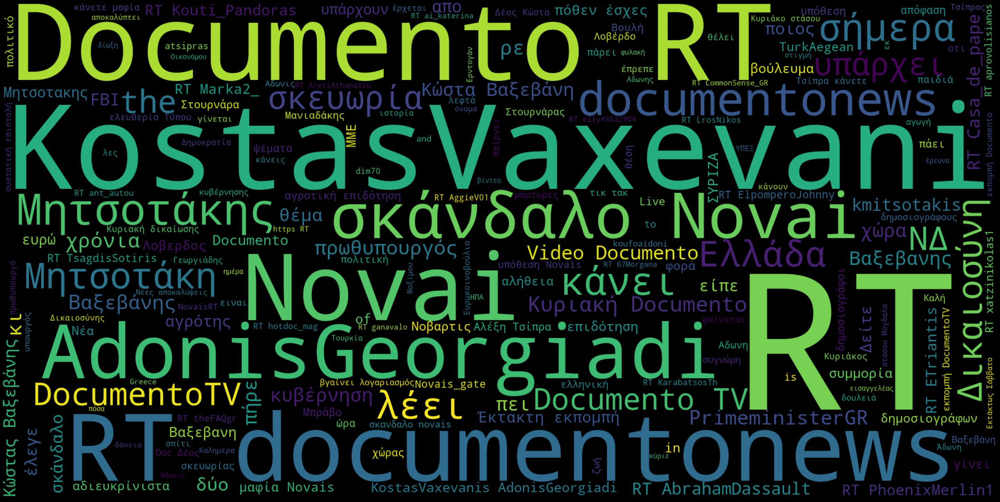

In [141]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words, 
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [142]:
from PIL import Image
import numpy as np

In [143]:
doc = nlp(Vax['text'][1])

In [144]:
for token in doc:
    print(token, token.lemma_)

@koskar2012 @koskar2012
Κανένα κανένα
πρόβλημα πρόβλημα
. .
Να Να
τις ο
δώσουμε δίνω


In [145]:
' '.join(token.lemma_ for token in doc)

'@koskar2012 κανένα πρόβλημα . Να ο δίνω'

In [146]:
text

'RT @ti_psifisate_re Που θα δείτε ρε μαλάκες Υπουργό άλλης χώρας να απευθύνεται σε δημοσιογράφο (με ό,τι κι αν του έχει σύρει εκείνος) και…@koskar2012 Κανένα πρόβλημα Να τις δώσουμεRT @trakterogege Εγώ @AdonisGeorgiadi θα πήγαινα αν ήμουν καθαρός ΑΝ ήμουν λέω  Πρόσεξε το ΑΝ ΗΜΟΥΝ RT @_VaLhaLLa_2 Τι να απαντήσεις αφού οποίο σκάνδαλο και βρωμοδουλεια υπάρχει, απο κάτω είσαι εσύ ΣπύροRT @ant_autou Αδιευκρινιστος Το τραγουδι που κλεινει την ωραια εκπομπη @ANASKOPISI_TPP  RT @LrosNikos Που είναι εκείνος ο Άδωνης που απειλούσε ότι θα έγδερνε,θα μήνυεθα εξόντωνε; Φοβάται μη γίνει στιφάδοθα προσφέρουμε…RT @LrosNikos Από το editorial του @KostasVaxevanis 👍👍👍  RT @constads Είναι ο Άδωνις το μεγαλύτερο σούργελο της μεταπολίτευσης;Η επιχειρηματολογία είναι επιπέδου "έδωσα συστατική επιστολή στον Τούρκο μαφιόζο γιατί ήταν αντικαθεστωτικός" Όποιος τον είπε γελοία πατσαβούρα της Βέρμαχτ τον αδίκησε  Επειδή δεν θέλουμε να αδικήσουμε τον Υπουργό, τον καλούμε για συνέντευξη στο #documentotv για να μας π

In [147]:
full_doc = nlp(text)
clear_text = ' '.join(token.lemma_ for token in full_doc)
clear_text[200:400]

'AdonisGeorgiadi θα πήγαινα αν ήμουν καθαρός ΑΝ ήμω λέω   Πρόσεξε ο ΑΝ ΗΜΟΥΝ RT @_VaLhaLLa_2 Τι να απαντήσεις αφού οποίος σκάνδαλο και βρωμοδουλεια υπάρχω , απο κάτω είσαι εσύ ΣπύροRT @ant_autou Αδιευκ'

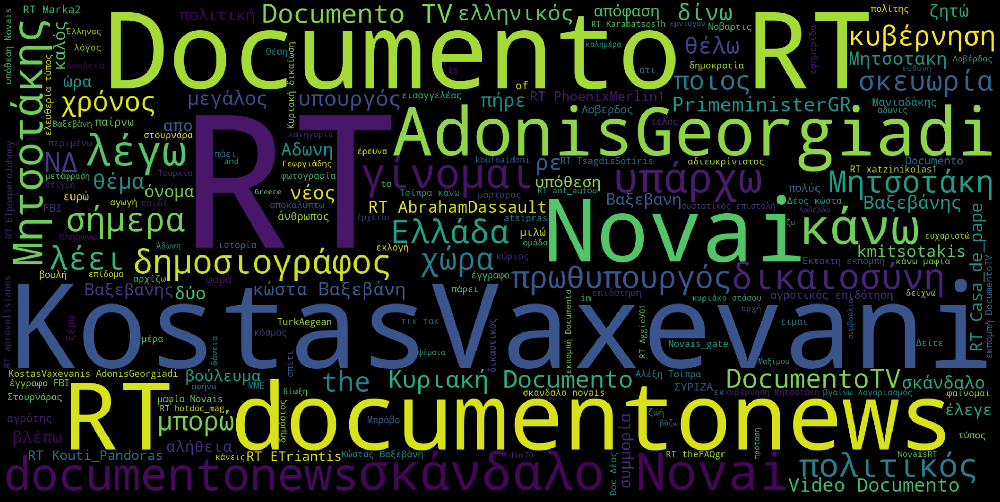

In [148]:
wordcloud = WordCloud(
    stopwords = nlp.Defaults.stop_words,
    width = 2000,
    height = 1000,
    background_color = 'black'
 ).generate(clear_text)
fig = plt.figure(
    figsize = (40, 30),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [149]:
from collections import Counter
Counter(" ".join(Vax["text"]).split()).most_common(16)

[('RT', 2797),
 ('και', 1115),
 ('το', 1046),
 ('να', 895),
 ('του', 893),
 ('για', 820),
 ('ο', 703),
 ('την', 613),
 ('με', 552),
 ('που', 543),
 ('τον', 540),
 ('η', 507),
 ('της', 490),
 ('τα', 425),
 ('από', 415),
 ('στο', 409)]

In [150]:
for word in nlp.Defaults.stop_words:
  print(word)
  break

λόγω


In [151]:
Vax['text_no_stopwords'] = Vax['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words) and word != ':' and word != '\n' and word != "amp" and word != 'rt' and word != ',']))
Vax['text_no_stopwords'] = Vax['text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (nlp.Defaults.stop_words)]))
Vax['clean_text_no_stopwords'] = Vax['text']
#for stopword in nlp.Defaults.stop_words:
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: ' '.join([word for word in x.split() if word not in nlp.Defaults.stop_words and word != "ή" and word != "ία" and word != "κι"]))
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace("amp", "").strip())
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace("rt", "").strip())
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace(":", "").strip())
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace(",", "").strip())
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace("\n", "").strip())
Vax['clean_text_no_stopwords'] = Vax['clean_text_no_stopwords'].apply(lambda x: x.replace(".", "").strip())

In [152]:
freq = Counter(" ".join(Vax["clean_text_no_stopwords"]).split()).most_common(16)
freq

[('RT', 2798),
 ('-', 404),
 ('Documento', 370),
 ('@KostasVaxevanis', 345),
 ('@documentonews', 308),
 ('Ο', 280),
 ('Η', 217),
 ('@AdonisGeorgiadi', 194),
 ('Το', 193),
 ('#Novais', 192),
 ('Novais', 185),
 ('Μητσοτάκη', 117),
 ('σκάνδαλο', 114),
 ('Και', 109),
 ('κ', 103),
 ('#Documento', 103)]

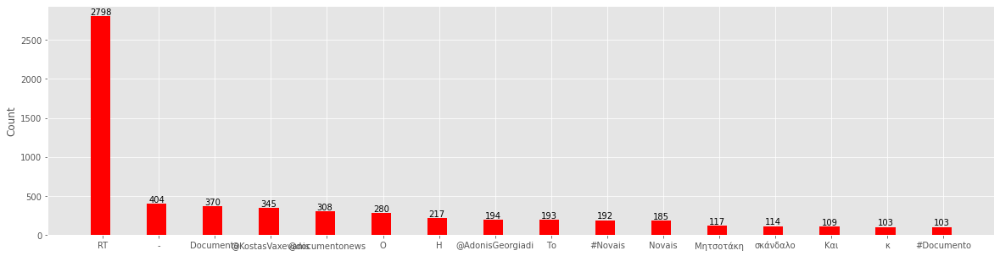

In [153]:
names, values = zip(*freq)
# names = [x[0] for x in data]  # These two lines are equivalent to the the zip-command.
# values = [x[1] for x in data] # These two lines are equivalent to the the zip-command.

ind = np.arange(len(freq))  # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots(figsize=(20,5))
rects1 = ax.bar(ind, values, width, color='r')
# add some text for labels, title and axes ticks
ax.set_ylabel('Count')
ax.set_xticks(ind+width/10.)
ax.set_xticklabels(names)

def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)

plt.show()

# vectorizing Vaxevanis

In [154]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()

In [155]:
count_vector = cv.fit_transform(Vax['text'])

In [156]:
count_vector.shape

(3244, 11740)

In [157]:
#cv.get_feature_names()

results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,000,004,035,05,080,098,0hpq2gjdrmzhaaq,10,100,...,ύπνο,ύπνου,ύποπτη,ύποπτο,ύστερα,ύψους,ών,ώρα,ώρες,ώστε
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [158]:
#cv.vocabulary_

In [159]:
cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95)

In [160]:
count_vector = cv.fit_transform(Vax['text'])

In [161]:
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 

results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,abrahamdassault,adonisgeorgiadi,amp,casa_de_pape,documento,documentonews,documentotv,etriantis,fbi,...,πρωθυπουργός,ρε,σήμερα,σκάνδαλο,σκευωρία,τύπου,υπάρχει,υπόθεση,χρόνια,χώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [162]:
from html import unescape
def my_tokenizer(doc):
            
    # apply the preprocessing and tokenzation steps
    doc_clean = unescape(doc).lower()
    tokens = nlp(doc_clean)
    lemmatized_tokens = [token.lemma_ for token in tokens if (len(str(token.lemma_))>2)]
            
    # use CountVectorizer's _word_ngrams built in method
    # to remove stop words and extract n-grams
    return(lemmatized_tokens)

In [163]:
cv = CountVectorizer(stop_words= nlp.Defaults.stop_words, min_df=0.01, max_df=0.95, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Vax['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['έκασε ο', 'έτερα', 'έτερων', 'ήσω', 'ίσιος', 'αλλιώ', 'αλλιώτικος', 'αλλοιώ', 'αρκετός', 'γίνομαι', 'γρήγορο', 'διο', 'είχος', 'εαυτής', 'εαυτός', 'εκάστος', 'επόμενος', 'εσένος', 'ετέραις', 'ετού', 'ετούε ο', 'εχτής', 'ιδίο', 'κάνενς', 'κάνω', 'κανενό', 'λοιπός', 'μέλλω', 'μερικός', 'μπορώ', 'μόνας', 'ολωσδιόλος', 'ορισμένος', 'οριόμενσς', 'ποία', 'πολύς', 'προτός', 'προχτής', 'σε ο', 'ταύ', 'τουλάχισε ο', 'τρίτος', 'τός', 'χωριστό'] not in stop_words.
  % sorted(inconsistent)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,\n\n,...,@abrahamdassault,@adonisgeorgiadi,@casa_de_pape,@documentonews,@etriantis,@kostasvaxevanis,@kouti_pandoras,@marka2,...,στουρνάρας,συμβούλιο,συμμορία,τύπος,υπάρχω,υπουργός,υπόθεση,χρόνος,χώρα,ώρα
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [164]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Vax['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,adonisgeorgiadi,documento,documentonews,documentotv,fbi,kostasvaxevanis,novartis,rt,the,βαξεβάνη,βαξεβάνης,εκπομπή,κάνει,κυριακή,λέει,μητσοτάκη,μητσοτάκης,πρωθυπουργός,σήμερα,σκάνδαλο
0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
4,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


In [165]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, token_pattern = '\\ουκ[α-ωά-ώ]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Vax['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,ουκάμισα,ουκέτο,ουκακι,ουκαράδες,ουκαριάρα,ουκασενκο,ουκιά,ουκιές,ουκο,ουκουλοφόροι,ουκουλοφόρος,ουκουλοφόρους,ουκουλοφόρων,ουκουλωσουν,ουκουλώματος,ουκούλωμα,ουκούλωσαν,ουκούλωσε,ουκούμι,ουκούτσι
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [166]:
results.sum(axis =0).sort_values(ascending = False)

ουκουλοφόροι     3
ουκουλοφόρους    3
ουκούλωμα        2
ουκιά            2
ουκο             2
ουκάμισα         1
ουκουλοφόρων     1
ουκούμι          1
ουκούλωσε        1
ουκούλωσαν       1
ουκουλώματος     1
ουκουλωσουν      1
ουκουλοφόρος     1
ουκέτο           1
ουκιές           1
ουκασενκο        1
ουκαριάρα        1
ουκαράδες        1
ουκακι           1
ουκούτσι         1
dtype: int64

In [167]:
sum_words =  results.sum(axis =0)
sum_words.sort_values(ascending = False).head()   

ουκουλοφόροι     3
ουκουλοφόρους    3
ουκούλωμα        2
ουκιά            2
ουκο             2
dtype: int64

In [168]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
 #                    token_pattern = '(\\bκ[οω]ρ[οω]ν[α-ωά-ώ]+\\b') )\| (\\bκυβ[α-ωά-ώ]\\b) #, tokenizer=my_tokenizer)
                     token_pattern = '\\bv[a-z0-9-_]*\\b') #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Vax['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,v-wade,v_andrianopulos,valiabazou,vanakosj,varzabetian,vasilisxtm,vassilisnalba,vaxevanis,venetia_ap,vepzvught9iapw2,video,view,viki55212057,viki_greece,vivian_e,vkatsardis,vkavourinos,vlahopoimenas,vmatiakis,vs
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [169]:
results.sum(axis =0).sort_values(ascending = False)

video              43
vepzvught9iapw2    12
venetia_ap         11
v_andrianopulos    10
viki55212057        9
vasilisxtm          7
varzabetian         6
vaxevanis           4
vkatsardis          4
valiabazou          3
viki_greece         3
vivian_e            2
vmatiakis           2
vlahopoimenas       2
vs                  2
vassilisnalba       2
vanakosj            2
view                1
vkavourinos         1
v-wade              1
dtype: int64

In [170]:
cv = CountVectorizer( stop_words= nlp.Defaults.stop_words, max_features=20, #ngram_range=(1, 2), 
                     vocabulary = ['Ukraine', 'Ουκρανία']) #, tokenizer=my_tokenizer)
count_vector = cv.fit_transform(Vax['text'])
results = pd.DataFrame(count_vector.toarray(), columns=cv.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Ukraine,Ουκρανία
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0


In [171]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [172]:
tfidf_vectorizer = TfidfVectorizer(stop_words= nlp.Defaults.stop_words, max_features=500)
tfidf_matrix_train = tfidf_vectorizer.fit_transform(Vax['text'])  #finds the tfidf score with normalization

In [173]:
results = pd.DataFrame(tfidf_matrix_train.toarray(), columns=tfidf_vectorizer.get_feature_names()) 
results.head()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,000,10,1821_2021,19,2022,21,22,30,500,...,χθες,χρέος,χρήμα,χρόνια,χώρα,χώρας,ψέματα,όνομα,όπλα,ώρα
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.452944,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0


In [174]:
from sklearn.metrics.pairwise import cosine_similarity

print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train[0:1], tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements


cosine scores ==>  [[1.         0.         0.02575834 ... 0.01216703 0.01033198 0.08871446]]


In [175]:
print("cosine scores ==> ",cosine_similarity(tfidf_matrix_train, tfidf_matrix_train))  #here the first element of tfidf_matrix_train is matched with other three elements


cosine scores ==>  [[1.         0.         0.02575834 ... 0.01216703 0.01033198 0.08871446]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.02575834 0.         1.         ... 0.03982113 0.03381526 0.29035113]
 ...
 [0.01216703 0.         0.03982113 ... 1.         0.12216098 0.1371482 ]
 [0.01033198 0.         0.03381526 ... 0.12216098 1.         0.11646333]
 [0.08871446 0.         0.29035113 ... 0.1371482  0.11646333 1.        ]]


In [176]:
arr = cosine_similarity(tfidf_matrix_train, tfidf_matrix_train)

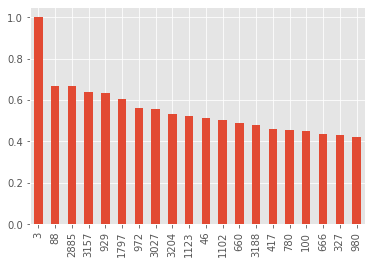

In [177]:
pd.DataFrame(arr).loc[3].sort_values(ascending = False).head(20).plot(kind = 'bar')

In [178]:
Vax['text'].loc[3]

'RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σκάνδαλο και βρωμοδουλεια υπάρχει, απο κάτω είσαι εσύ Σπύρο'

In [179]:
Vax['text'].loc[823]

"RT @mixalis_lgs: 'Κύριε' @AdonisGeorgiadi περιμένουμε και σήμερα τη παραίτηση σας μετά το #turkagean  και τη δημόσια συγνώμη σας προς το πρ…"

# Emolex Vaxdf

In [180]:
filepath = "https://raw.githubusercontent.com/datajour-gr/Data_journalism/master/week10/NRC_GREEK_Translated_6_2020.csv"
emolex_df = pd.read_csv(filepath)
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [181]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13166,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13167,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13168,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13169,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13170,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [182]:
emolex_df = emolex_df.drop_duplicates(subset=['word'])
emolex_df = emolex_df.dropna()
emolex_df.reset_index(drop = True, inplace = True)

In [183]:
emolex_df.tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
13157,κροκος αυγου,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13158,νεοτερος,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13159,ζεφυρος,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13160,ζουμ,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [184]:
import spacy
nlp = spacy.load('el_core_news_sm')

In [185]:
Vax_tweets_df = pd.read_csv("/content/gdrive/My Drive/Colab Notebooks/Vax.tsv", sep='\t')

In [186]:
len(Vax_tweets_df)

3244

In [187]:
short_tweets_Vax = Vax_tweets_df[['created_at','full_text' ]]
short_tweets_Vax = short_tweets_Vax.rename(columns={'created_at': 'date', 'full_text': 'text'} )

In [188]:
short_tweets_Vax.tail()

,date,text
3239,Thu Jun 02 20:31:11 +0000 2022,RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...
3240,Thu Jun 02 20:31:02 +0000 2022,RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...
3241,Thu Jun 02 20:29:54 +0000 2022,RT @TassosMorfis: Αυτά που γίνονται με το σκάν...
3242,Thu Jun 02 20:21:42 +0000 2022,RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...
3243,Thu Jun 02 20:20:59 +0000 2022,RT @aeisixtir: 🤣🤣🤣🤣


In [189]:
short_tweets_Vax.dtypes

date    object
text    object
dtype: object

In [190]:
short_tweets_Vax['date'] = pd.to_datetime(short_tweets_Vax['date'], format='%a %b %d %H:%M:%S +0000 %Y')

In [191]:
short_tweets_Vax['year'] = pd.DatetimeIndex(short_tweets_Vax['date']).year
short_tweets_Vax['month'] = pd.DatetimeIndex(short_tweets_Vax['date']).month
short_tweets_Vax['day'] = pd.DatetimeIndex(short_tweets_Vax['date']).day
short_tweets_Vax

,date,text,year,month,day
0,2022-07-10 13:25:50,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,2022,7,10
1,2022-07-10 13:25:35,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,2022,7,10
2,2022-07-10 13:24:22,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,2022,7,10
3,2022-07-10 13:22:19,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,2022,7,10
4,2022-07-10 13:20:39,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,2022,7,10
...,...,...,...,...,...
3239,2022-06-02 20:31:11,RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...,2022,6,2
3240,2022-06-02 20:31:02,RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...,2022,6,2
3241,2022-06-02 20:29:54,RT @TassosMorfis: Αυτά που γίνονται με το σκάν...,2022,6,2
3242,2022-06-02 20:21:42,RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...,2022,6,2


In [192]:
short_tweets_Vax.dtypes

date     datetime64[ns]
text             object
year              int64
month             int64
day               int64
dtype: object

In [193]:
emolex_df['word'].head(3)

0              αφεση
1    ενορκη βεβαιωση
2            εχοντας
Name: word, dtype: object

In [194]:
short_tweets_Vax['text'] = short_tweets_Vax['text'].str.replace(r'https?:\/\/.*[\r\n]*'," ")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  """Entry point for launching an IPython kernel.


In [195]:
short_tweets_Vax.head()

,date,text,year,month,day
0,2022-07-10 13:25:50,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,2022,7,10
1,2022-07-10 13:25:35,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,2022,7,10
2,2022-07-10 13:24:22,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,2022,7,10
3,2022-07-10 13:22:19,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,2022,7,10
4,2022-07-10 13:20:39,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,2022,7,10


In [196]:
vec = CountVectorizer(analyzer = 'word', vocabulary = emolex_df.word, 
                      strip_accents = 'unicode',  
                      stop_words= nlp.Defaults.stop_words,
                      ngram_range=(1, 2))

In [197]:
#from sklearn.feature_extraction.text import TfidfVectorizer
#CountVectorizer(stop_words='english', binary=True)
# Θέλω να ελέγξω μόνο τις λέξεις που υπάρχουν στο συναισθηματικό λεξικό

#CountVectorizer(analyzer = 'word', 
#              strip_accents = 'unicode', 
#               token_pattern='[Α-Ωα-ωΆ-Ώά-ώ]{2,}', 
#               stop_words= lc_stop_words_df['stop_w'].tolist())


matrix = vec.fit_transform(short_tweets_Vax['text'])
vocab = vec.get_feature_names()
wordcount_df = pd.DataFrame(matrix.toarray(), columns=vocab)
wordcount_df.head()

/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:1323: UserWarning: Upper case characters found in vocabulary while 'lowercase' is True. These entries will not be matched with any documents
  "Upper case characters found in"
/usr/local/lib/python3.7/dist-packages/sklearn/feature_extraction/text.py:401: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['αδιακοπα', 'ακομα', 'ακομη', 'ακριβως', 'αλλα', 'αλλαχου', 'αλλες', 'αλλη', 'αλλην', 'αλλης', 'αλλιως', 'αλλιωτικα', 'αλλο', 'αλλοι', 'αλλοιως', 'αλλοιωτικα', 'αλλον', 'αλλος', 'αλλοτε', 'αλλου', 'αλλους', 'αλλων', 'αμα', 'αμεσα', 'αμεσως', 'ανα', 'αναμεσα', 'αναμεταξυ', 'ανευ', 'αντι', 'αντιπερα', 'αντις', 'ανω', 'ανωτερω', 'αξαφνα', 'απεναντι', 'απο', 'αποψε', 'αρα', 'αραγε', 'αρκετα', 'αρκετες', 'αρχικα', 'αυριο', 'αυτα', 'αυτες', 'αυτη', 'αυτην', 'αυτης', 'αυτο', 'αυτοι', 'αυτον', 'αυτος', 'αυτου', 'αυτους', 'αυτων', 'αφοτου', 'αφου', 'βεβαια

,αφεση,ενορκη βεβαιωση,εχοντας,εχω,οριο,ορμος,υδρα,αγια τραπεζα,αμην,απατσι,...,κλητηριο ενταλμα,κατειργασμενος,μαγια,κιτρινο,κιτρινιζω,ουρλιασμα,κροκος αυγου,νεοτερος,ζεφυρος,ζουμ
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [198]:
wordcount_df.shape

(3244, 13161)

In [199]:
emolex_df.head()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
0,αφεση,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,ενορκη βεβαιωση,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,εχοντας,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,εχω,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,οριο,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [200]:
emolex_df[emolex_df.Anger == 1].tail()

,word,Positive,Negative,Anger,Anticipation,Disgust,Fear,Joy,Sadness,Surprise,Trust
13094,διεξοδος,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13096,ζωυφια,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
13100,θυματοποιω,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0
13128,αποτυχημενος,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
13156,ουρλιασμα,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [201]:
# Φτιάξε μια λίστα με positive words

angry_words = emolex_df[emolex_df.Anger == 1]['word']

positive_words = emolex_df[emolex_df.Positive == 1]['word']


# Φτιάξε μια λίστα με sadness words
sadness_words = emolex_df[emolex_df.Sadness == 1]['word']


# Φτιάξε μια λίστα με surprise words
surprise_words = emolex_df[emolex_df.Surprise == 1]['word']


# Φτιάξε μια λίστα με disgust words
disgust_words = emolex_df[emolex_df.Disgust == 1]['word']


# Φτιάξε μια λίστα με anticipation words
anticipation_words = emolex_df[emolex_df.Anticipation == 1]['word']


# Φτιάξε μια λίστα με negative words
negative_words = emolex_df[emolex_df.Negative == 1]['word']



# Φτιάξε μια λίστα με joy words
joy_words = emolex_df[emolex_df.Joy == 1]['word']


# Φτιάξε μια λίστα με trust words
trust_words = emolex_df[emolex_df.Trust == 1]['word']



# Φτιάξε μια λίστα με fear words
fear_words = emolex_df[emolex_df.Fear == 1]['word']


In [202]:
short_tweets_Vax.head(3)

,date,text,year,month,day
0,2022-07-10 13:25:50,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,2022,7,10
1,2022-07-10 13:25:35,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,2022,7,10
2,2022-07-10 13:24:22,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,2022,7,10


In [203]:
short_tweets_Vax['anger'] = wordcount_df[angry_words].sum(axis=1)

short_tweets_Vax['positivity'] = wordcount_df[positive_words].sum(axis=1)


short_tweets_Vax['joy'] = wordcount_df[joy_words].sum(axis=1)


short_tweets_Vax['disgust'] = wordcount_df[disgust_words].sum(axis=1)


short_tweets_Vax['surprise'] = wordcount_df[surprise_words].sum(axis=1)

short_tweets_Vax['trust'] = wordcount_df[trust_words].sum(axis=1)


short_tweets_Vax['anticipation'] = wordcount_df[anticipation_words].sum(axis=1)


short_tweets_Vax['sadness'] = wordcount_df[sadness_words].sum(axis=1)

short_tweets_Vax['negative'] = wordcount_df[negative_words].sum(axis=1)

short_tweets_Vax['fear'] = wordcount_df[fear_words].sum(axis=1)


In [204]:
short_tweets_Vax

,date,text,year,month,day,anger,positivity,joy,disgust,surprise,trust,anticipation,sadness,negative,fear
0,2022-07-10 13:25:50,RT @ti_psifisate_re: Που θα δείτε ρε μαλάκες Υ...,2022,7,10,0,0,0,1,0,0,0,0,0,0
1,2022-07-10 13:25:35,@koskar2012 Κανένα πρόβλημα. Να τις δώσουμε,2022,7,10,0,0,0,0,0,0,0,1,1,1
2,2022-07-10 13:24:22,RT @trakterogege: Εγώ @AdonisGeorgiadi θα πήγα...,2022,7,10,0,1,1,0,0,1,0,0,0,0
3,2022-07-10 13:22:19,RT @_VaLhaLLa_2: Τι να απαντήσεις αφού οποίο σ...,2022,7,10,0,1,1,0,1,0,0,0,1,1
4,2022-07-10 13:20:39,RT @ant_autou: Αδιευκρινιστος. Το τραγουδι που...,2022,7,10,1,2,1,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3239,2022-06-02 20:31:11,RT @VePZVughT9Iapw2: Ζούμε στη χώρα που αντί ν...,2022,6,2,1,1,0,0,0,1,0,1,1,1
3240,2022-06-02 20:31:02,RT @rapidis: Συνεχίζεται η ομερτά από τη μεγάλ...,2022,6,2,0,1,1,0,0,1,0,0,0,0
3241,2022-06-02 20:29:54,RT @TassosMorfis: Αυτά που γίνονται με το σκάν...,2022,6,2,0,0,0,0,0,0,0,0,1,1
3242,2022-06-02 20:21:42,RT @Aegean_Cypress: Στα πόσα ψευδόμενα υπουργε...,2022,6,2,0,0,0,0,0,0,0,1,1,0


In [205]:
max = 0
happiest_tweet = ""
for i in range(0,len(short_tweets_Vax)):
  #print(short_tweets_Vax.iloc[i]['positivity'])
  if short_tweets_Vax.iloc[i]['positivity'] > max:
    happiest_tweet = short_tweets_Vax.iloc[i]['text']
    max = short_tweets_Vax.iloc[i]['positivity']


happiest_tweet

'1.O  μάρτυρας καταθέτει στο FBI ότι η #Novartis χρημάτιζε τον @AdonisGeorgiadi δίνοντας μετρητά στη γραμματέα του\n2.Η εισαγγελική έρευνα εντόπισε στις καταθέσεις του, μετρητά από τη γραμματέα του\n3.Ο Εισαγγελέας δεν τους καλεί, τα λέει "αδιευκρίνιστα" \n4.Ο Αδωνης κάνει τον τρελό  '

In [206]:
max = 0
negative_tweet = ""
for i in range(0,len(short_tweets_Vax)):
  #print(short_tweets_Vax.iloc[i]['positivity'])
  if short_tweets_Vax.iloc[i]['negative'] > max:
    negative_tweet = short_tweets_Vax.iloc[i]['text']
    max = short_tweets_Vax.iloc[i]['negative']


negative_tweet

'Πρέπει να απαντήσει η κυβέρνηση, γιατί οι Κούρδοι ως διωκόμενοι από τον Ερντογάν δεν παίρνουν άσυλο, αλλά παίρνει ο μαφιόζος ως εχθρός του Ερντογάν. Και δεν παίρνει μόνο άσυλο αλλά και ελληνική υποκοότητα με πρόταση @AdonisGeorgiadi Μάλλον είναι... λεπτό το ζήτημα'

In [207]:
max = 0
saddest_tweet = ""
for i in range(0,len(short_tweets_Vax)):
  #print(short_tweets_Vax.iloc[i]['positivity'])
  if short_tweets_Vax.iloc[i]['sadness'] > max:
    saddest_tweet = short_tweets_Vax.iloc[i]['text']
    max = short_tweets_Vax.iloc[i]['sadness']

saddest_tweet

'RT @thalassinos2001: Μη βρεθούνε 7 εκατομμύρια χωρίς παραστατικά και 350 χιλιάρικα αδιευκρίνιστα αμέσως να πείτε κλέφτης,φυλακή και σκάνδαλ…'

In [208]:
max = 0
fear_tweet = ""
for i in range(0,len(short_tweets_Vax)):
  #print(short_tweets_Vax.iloc[i]['positivity'])
  if short_tweets_Vax.iloc[i]['fear'] > max:
    fear_tweet = short_tweets_Vax.iloc[i]['text']
    max = short_tweets_Vax.iloc[i]['fear']

fear_tweet

'Πρέπει να απαντήσει η κυβέρνηση, γιατί οι Κούρδοι ως διωκόμενοι από τον Ερντογάν δεν παίρνουν άσυλο, αλλά παίρνει ο μαφιόζος ως εχθρός του Ερντογάν. Και δεν παίρνει μόνο άσυλο αλλά και ελληνική υποκοότητα με πρόταση @AdonisGeorgiadi Μάλλον είναι... λεπτό το ζήτημα'

In [209]:
max = 0
trust_tweet = ""
for i in range(0,len(short_tweets_Vax)):
  #print(short_tweets_Vax.iloc[i]['positivity'])
  if short_tweets_Vax.iloc[i]['trust'] > max:
    trust_tweet = short_tweets_Vax.iloc[i]['text']
    max = short_tweets_Vax.iloc[i]['trust']

trust_tweet

'Η μάρτυρας Κελεση (πλήρως αξιόπιστη κατά το Βούλευμα και μάρτυρας FBI) , έχει καταθέσει ότι ο Φρουζής χρημάτιζε τον @AdonisGeorgiadi μέσω της γραμματέως του Κατραβά. Στους λογαριασμούς Άδωνη βρέθηκαν καταθέσεις από την  Κατραβά  Και ο Εισαγγελέας;\n\n '

In [210]:
short_tweets_Vax.set_index('date' , inplace=True)

In [211]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')

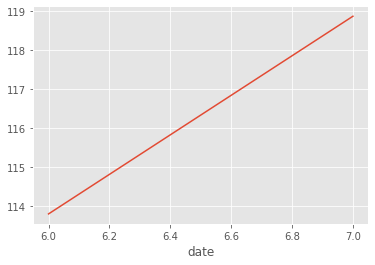

In [212]:
short_tweets_Vax['text'].str.len().groupby(by=short_tweets_Vax.index.month).mean().plot()

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:1200: UserWarning: Attempting to set identical left == right == 52.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


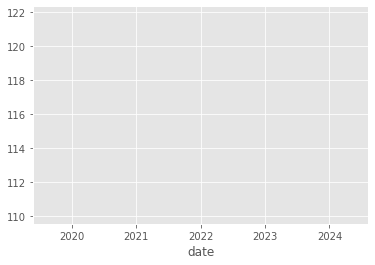

In [213]:
short_tweets_Vax['text'].str.len().resample('A').mean().plot() 

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:1200: UserWarning: Attempting to set identical left == right == 52.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


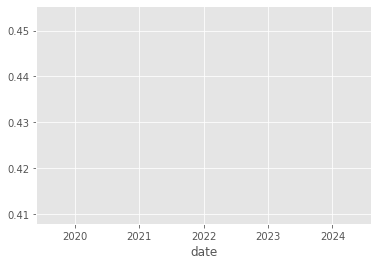

In [214]:
short_tweets_Vax['positivity'].resample('A').mean().plot() 

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:1200: UserWarning: Attempting to set identical left == right == 52.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


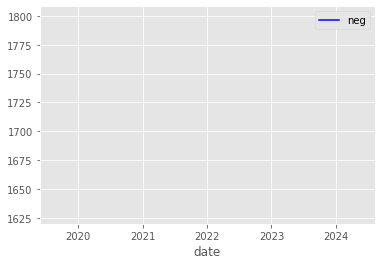

In [215]:
short_tweets_Vax['negative'].resample('A').sum().plot(color = 'b',label = 'neg').legend() 

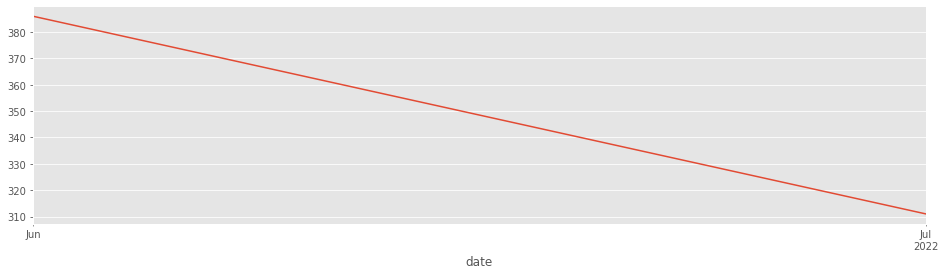

In [216]:
short_tweets_Vax['anger'].resample('M').sum().plot(figsize=(16,4))

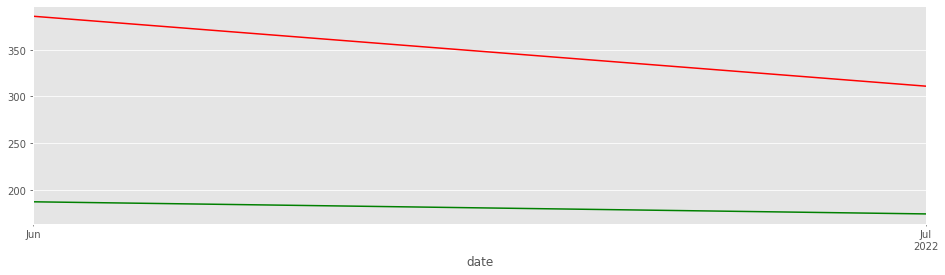

In [217]:
ax = short_tweets_Vax['anger'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Vax['joy'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')

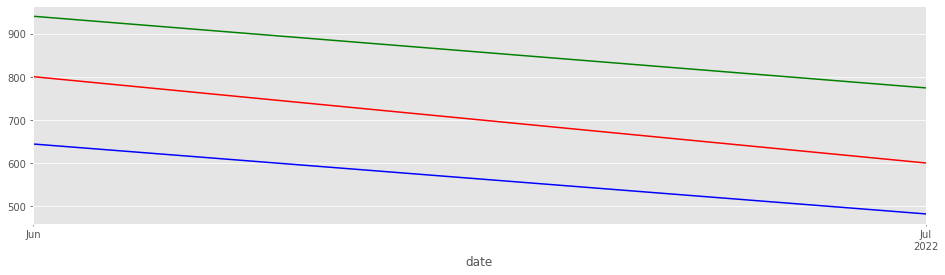

In [218]:
ax = short_tweets_Vax['positivity'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Vax['negative'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_Vax['trust'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'blue')

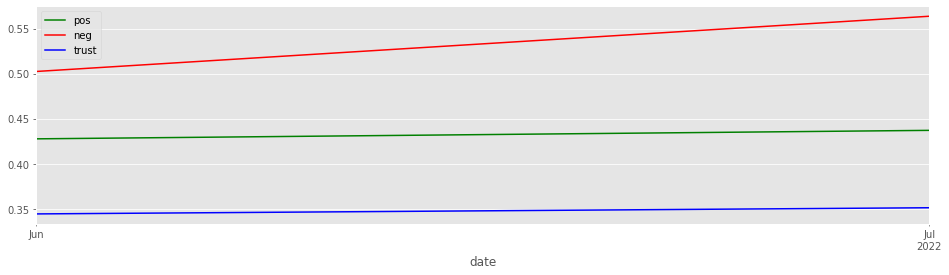

In [219]:
ax = short_tweets_Vax['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_Vax['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_Vax['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

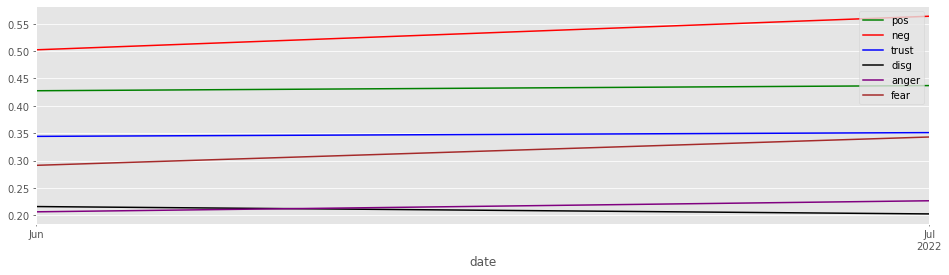

In [220]:
plt.style.use('ggplot')
ax = short_tweets_Vax['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos')
short_tweets_Vax['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg', color = 'r')
short_tweets_Vax['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust',color = 'blue').legend()

short_tweets_Vax['disgust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'disg',color = 'black').legend() 

short_tweets_Vax['anger'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'anger',color = 'purple').legend() 

short_tweets_Vax['fear'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'fear',color = 'brown').legend()    

Text(0, 0.5, 'Years')

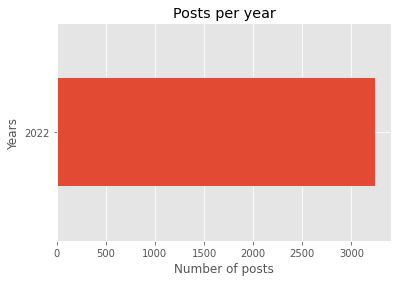

In [221]:
short_tweets_Vax['text'].groupby(by=short_tweets_Vax.index.year).count().plot(kind='barh')
plt.title("Posts per year")
plt.xlabel("Number of posts")
plt.ylabel("Years")

Text(0, 0.5, 'Month of the year')

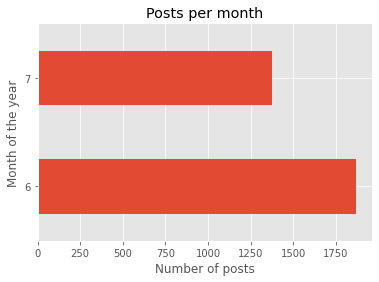

In [222]:
short_tweets_Vax['text'].groupby(by=short_tweets_Vax.index.month).count().plot(kind='barh')
plt.title("Posts per month")
plt.xlabel("Number of posts")
plt.ylabel("Month of the year")

Text(0, 0.5, 'Hour of the day')

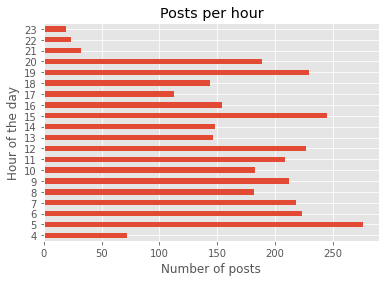

In [223]:
short_tweets_Vax['text'].groupby(by=short_tweets_Vax.index.hour).count().plot(kind='barh')
plt.title("Posts per hour")
plt.xlabel("Number of posts")
plt.ylabel("Hour of the day")

# Arisdf - Vaxdf

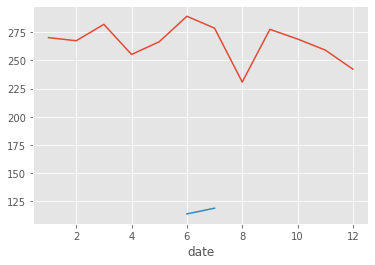

In [224]:
short_tweets_Aris['text'].str.len().groupby(by=short_tweets_Aris.index.month).mean().plot()
short_tweets_Vax['text'].str.len().groupby(by=short_tweets_Vax.index.month).mean().plot()

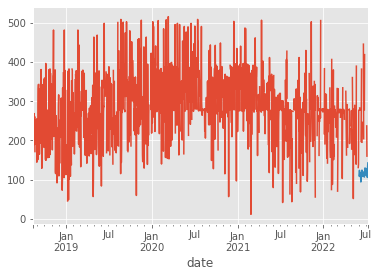

In [225]:
short_tweets_Aris['text'].str.len().resample('D').mean().plot() 
short_tweets_Vax['text'].str.len().resample('D').mean().plot() 

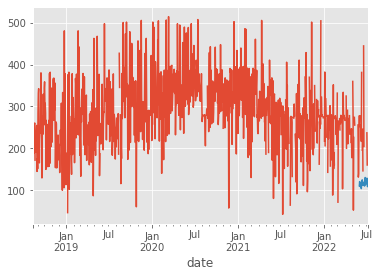

In [226]:
short_tweets_Aris['text'].str.len().resample('B').mean().plot() 
short_tweets_Vax['text'].str.len().resample('B').mean().plot() 

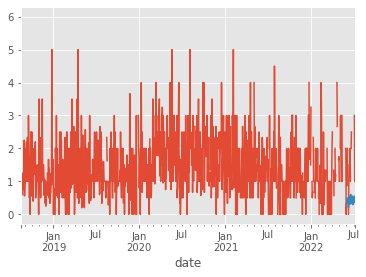

In [227]:
short_tweets_Aris['positivity'].resample('B').mean().plot() 
short_tweets_Vax['positivity'].resample('B').mean().plot() 

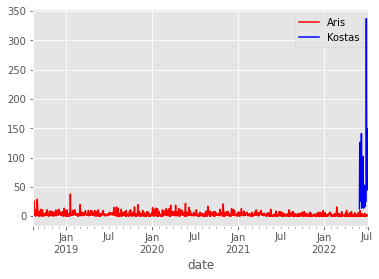

In [228]:
short_tweets_Aris['negative'].resample('B').sum().plot(color = 'r',label = 'Aris').legend() 
short_tweets_Vax['negative'].resample('B').sum().plot(color = 'b',label = 'Kostas').legend() 

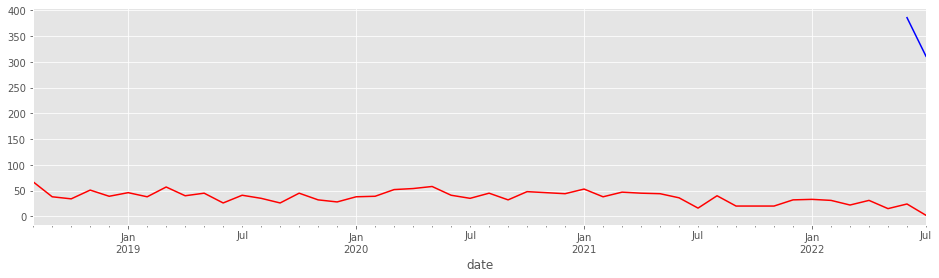

In [229]:
short_tweets_Aris['anger'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Vax['anger'].resample('M').sum().plot(figsize=(16,4), color = 'blue')

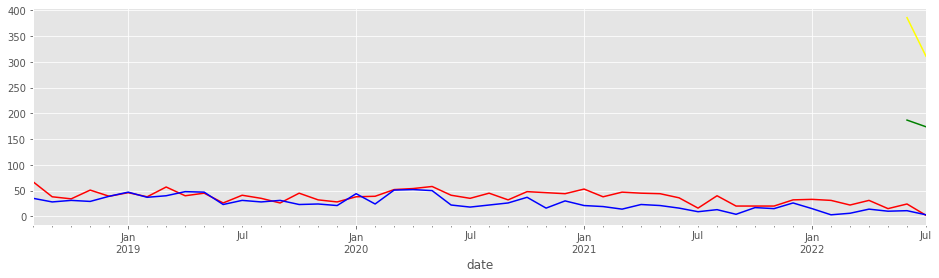

In [230]:
ax = short_tweets_Aris['anger'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Aris['joy'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'blue')
ax = short_tweets_Vax['anger'].resample('M').sum().plot(figsize=(16,4), color = 'yellow')
short_tweets_Vax['joy'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')

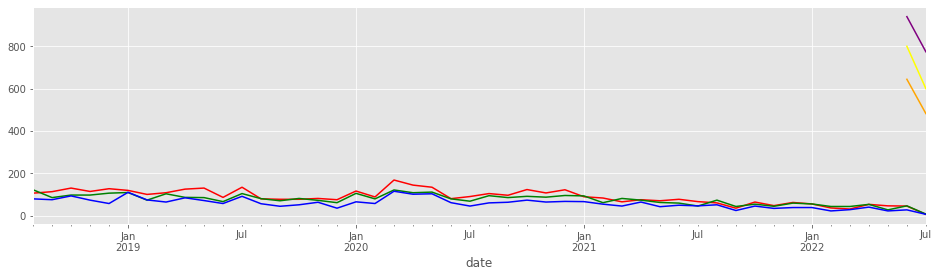

In [231]:
ax = short_tweets_Aris['positivity'].resample('M').sum().plot(figsize=(16,4), color = 'red')
short_tweets_Aris['negative'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'green')
short_tweets_Aris['trust'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'blue')
ax = short_tweets_Vax['positivity'].resample('M').sum().plot(figsize=(16,4), color = 'yellow')
short_tweets_Vax['negative'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'purple')
short_tweets_Vax['trust'].resample('M').sum().plot(figsize=(16,4), ax = ax, color = 'orange')

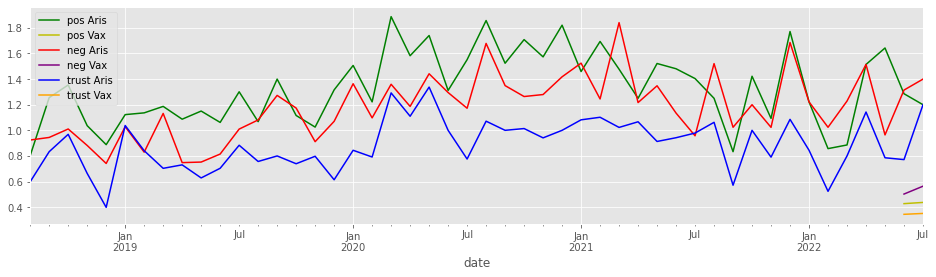

In [232]:
ax = short_tweets_Aris['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos Aris')
ax = short_tweets_Vax['positivity'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'y', label='pos Vax')
short_tweets_Aris['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg Aris', color = 'r')
short_tweets_Vax['negative'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg Vax', color = 'purple')
short_tweets_Aris['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust Aris',color = 'blue').legend()
short_tweets_Vax['trust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust Vax',color = 'orange').legend()

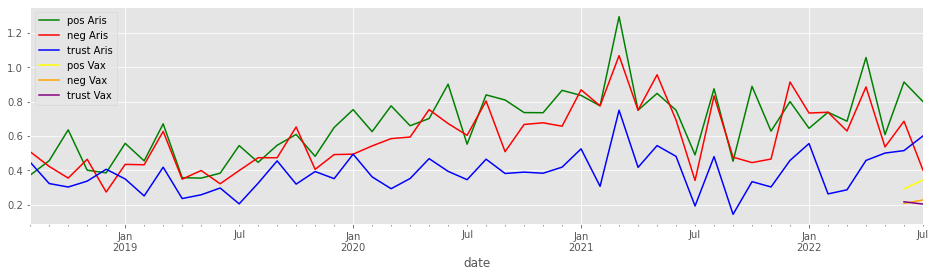

In [233]:
plt.style.use('ggplot')
ax = short_tweets_Aris['fear'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'g', label='pos Aris')
short_tweets_Aris['anger'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg Aris', color = 'r')
short_tweets_Aris['disgust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust Aris',color = 'blue').legend()    
short_tweets_Vax['fear'].resample('M').mean().plot(figsize=(16,4), 
                                                          color = 'yellow', label='pos Vax')
short_tweets_Vax['anger'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                   label = 'neg Vax', color = 'orange')
short_tweets_Vax['disgust'].resample('M').mean().plot(figsize=(16,4), ax = ax, 
                                                label = 'trust Vax',color = 'purple').legend()                                                